# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [21]:
import numpy as np

In [42]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    
    combined = torch.cat((x.float(),y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [43]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [44]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [45]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [50]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = n_classes + mnist_shape[0] 
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [51]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [52]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0672884038686754, discriminator loss: 0.2921234872713685


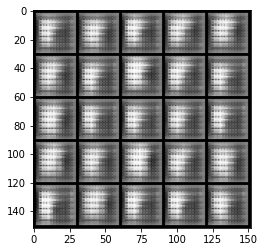

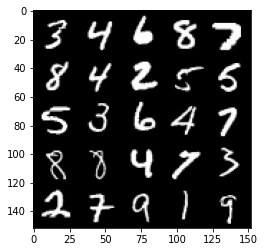

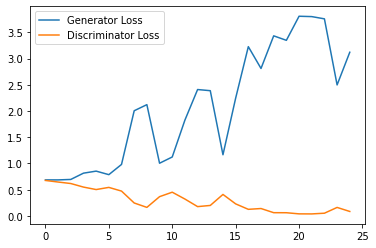

Step 1000: Generator loss: 3.4033941764831543, discriminator loss: 0.12414433310925961


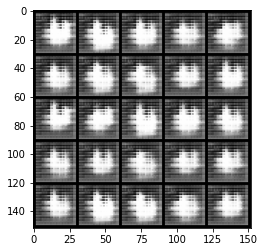

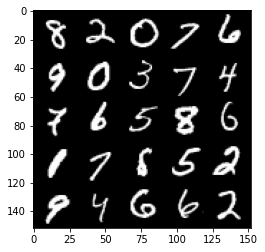

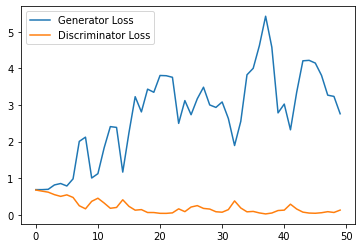

Step 1500: Generator loss: 3.5096575462818147, discriminator loss: 0.1105147721413523


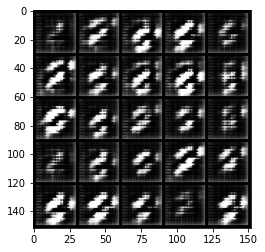

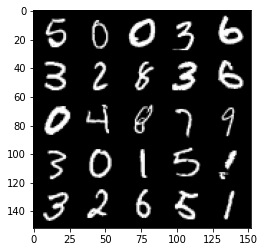

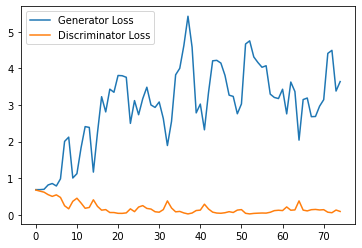

Step 2000: Generator loss: 3.5842597103118896, discriminator loss: 0.10821484192088246


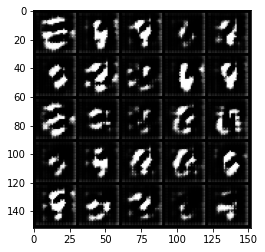

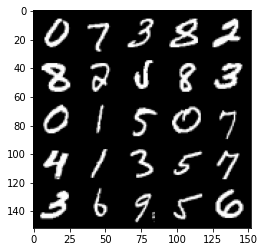

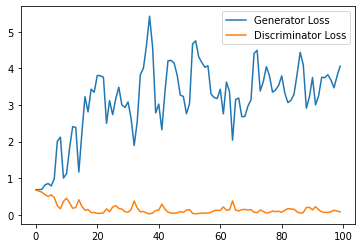

Step 2500: Generator loss: 2.602780259609222, discriminator loss: 0.21527369080483913


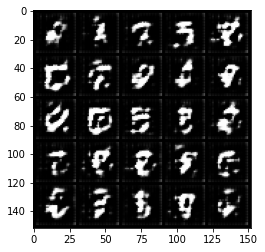

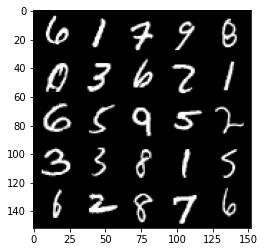

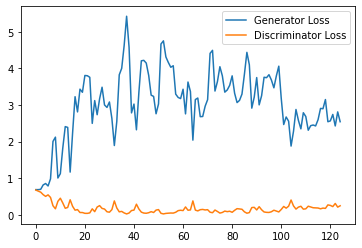

Step 3000: Generator loss: 2.1438047018051147, discriminator loss: 0.34693360126018524


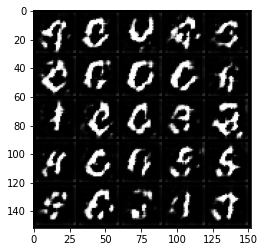

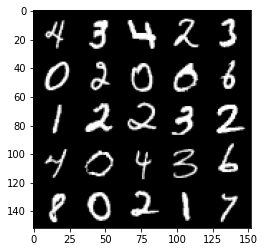

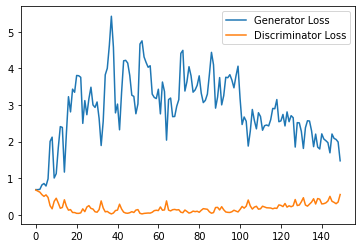

Step 3500: Generator loss: 1.9516124029159545, discriminator loss: 0.3806965582370758


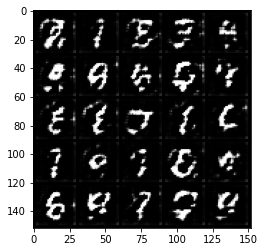

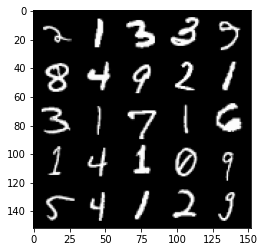

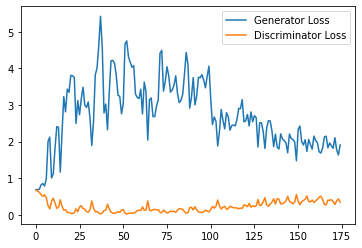

Step 4000: Generator loss: 1.7908573191165924, discriminator loss: 0.37185598322749136


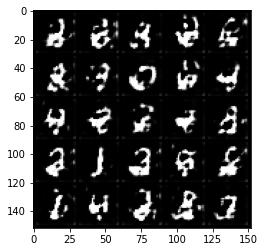

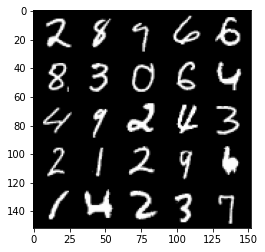

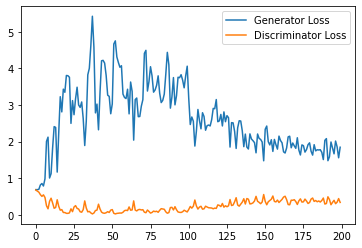

Step 4500: Generator loss: 1.6906055121421815, discriminator loss: 0.3756948810815811


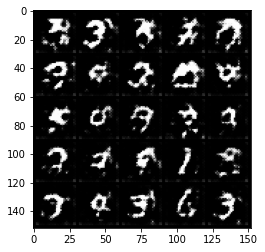

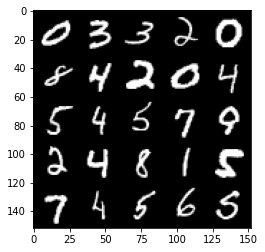

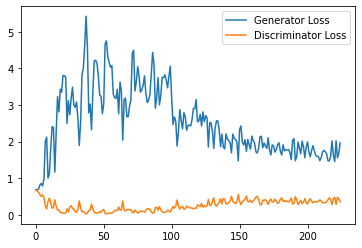

Step 5000: Generator loss: 1.8577239084243775, discriminator loss: 0.39420284250378607


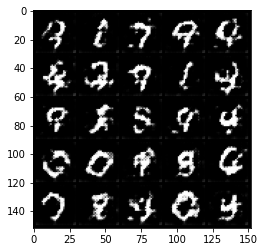

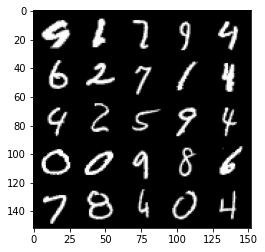

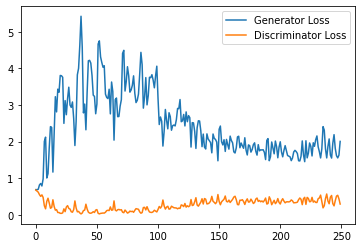

Step 5500: Generator loss: 1.6546360504627229, discriminator loss: 0.38268494069576264


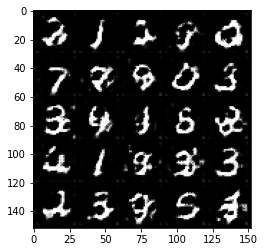

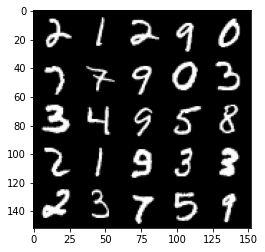

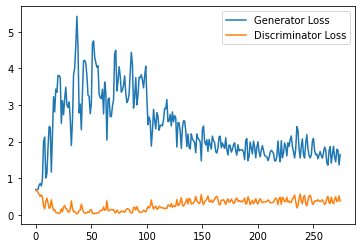

Step 6000: Generator loss: 1.5819271488189697, discriminator loss: 0.4129255127906799


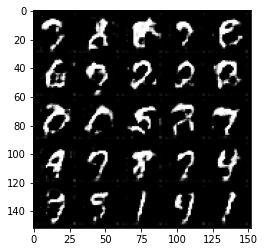

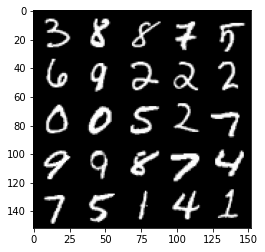

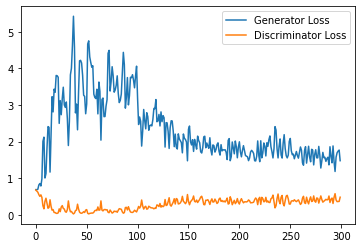

Step 6500: Generator loss: 1.6105937342643737, discriminator loss: 0.45926019236445426


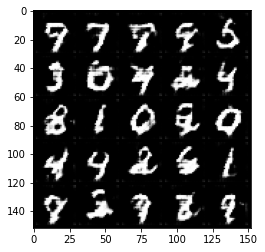

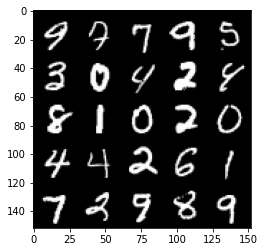

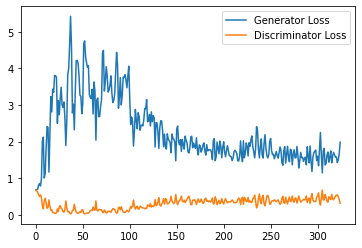

Step 7000: Generator loss: 1.4862012710571288, discriminator loss: 0.46644670563936236


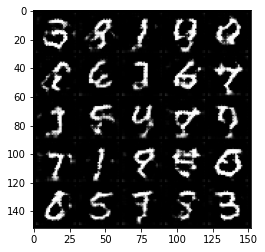

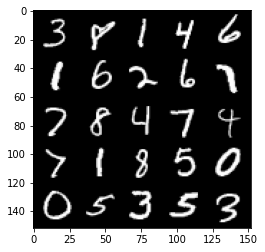

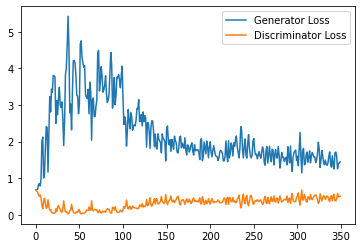

Step 7500: Generator loss: 1.4863288514614106, discriminator loss: 0.4773594683408737


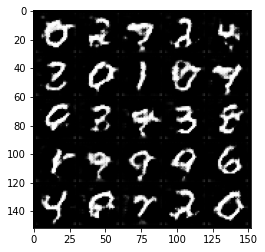

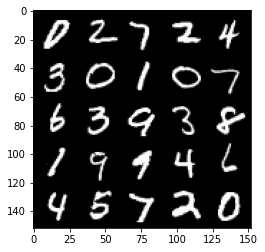

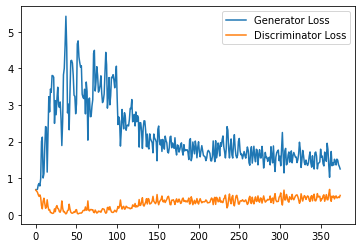

Step 8000: Generator loss: 1.3805564087629318, discriminator loss: 0.485489493906498


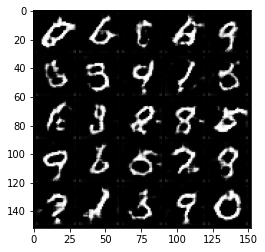

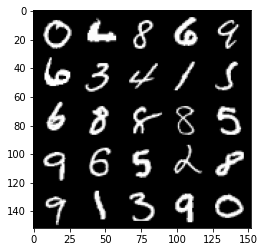

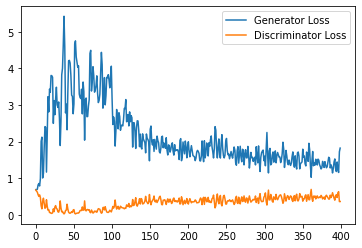

Step 8500: Generator loss: 1.3181128749847413, discriminator loss: 0.5132347891330719


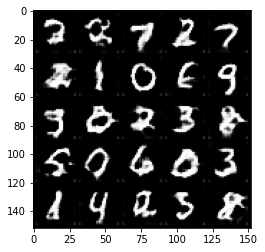

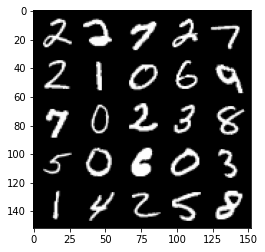

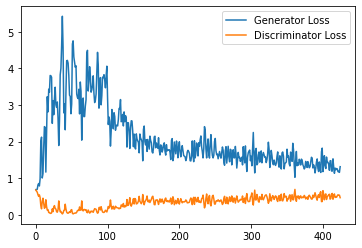

Step 9000: Generator loss: 1.24846737742424, discriminator loss: 0.5156617501378059


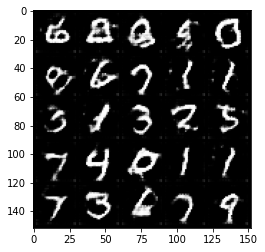

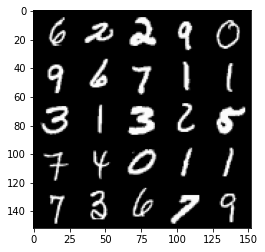

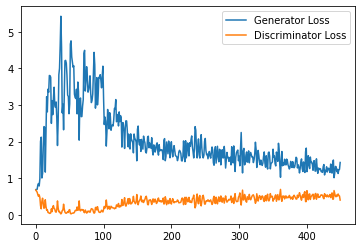

Step 9500: Generator loss: 1.2456080300807952, discriminator loss: 0.5218261835575104


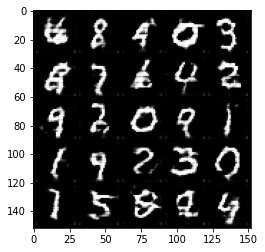

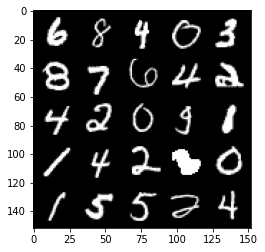

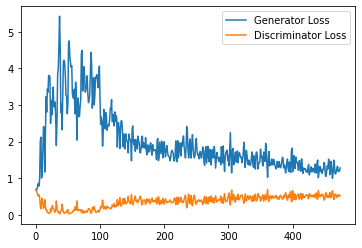

Step 10000: Generator loss: 1.2664228847026826, discriminator loss: 0.5359474056363106


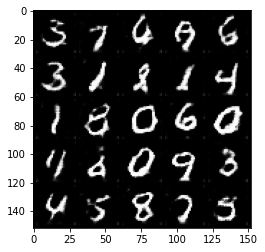

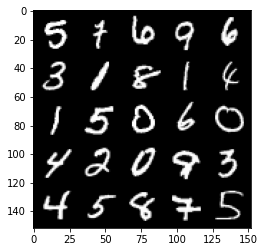

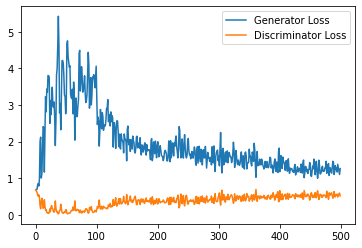

Step 10500: Generator loss: 1.2053846819400786, discriminator loss: 0.5440548807382584


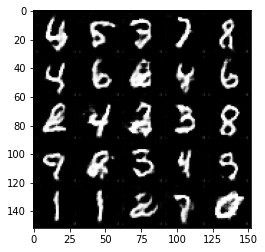

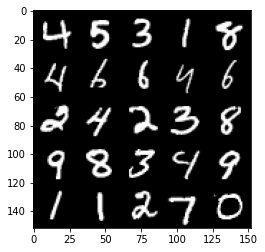

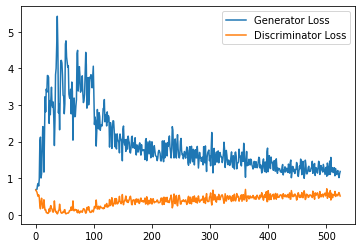

Step 11000: Generator loss: 1.2096007943153382, discriminator loss: 0.5535565446615219


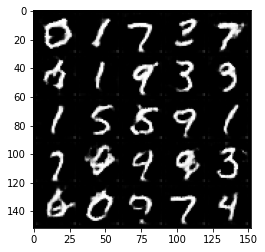

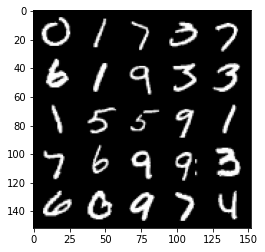

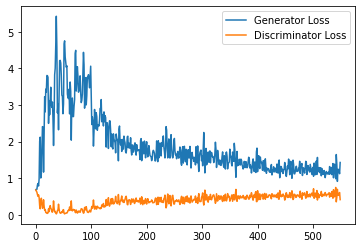

Step 11500: Generator loss: 1.1381354911327362, discriminator loss: 0.5543721765875816


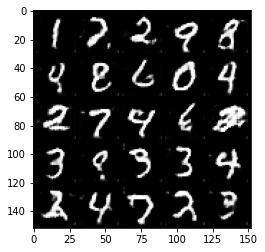

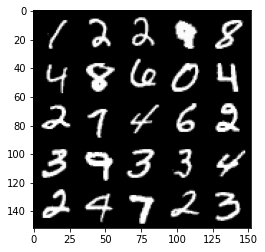

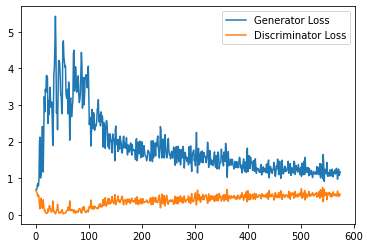

Step 12000: Generator loss: 1.1515667402744294, discriminator loss: 0.5515967817306519


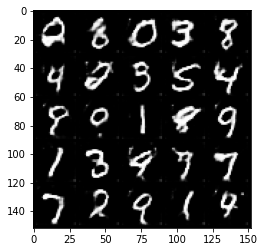

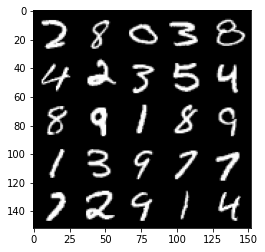

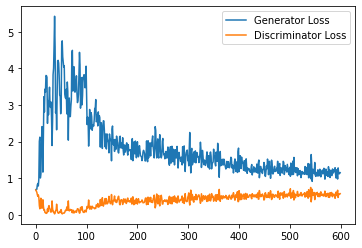

Step 12500: Generator loss: 1.1428383905887605, discriminator loss: 0.5609451634287834


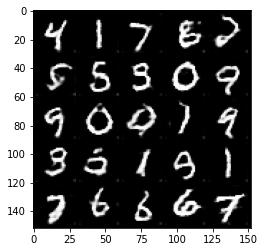

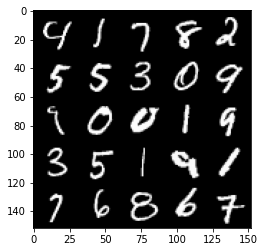

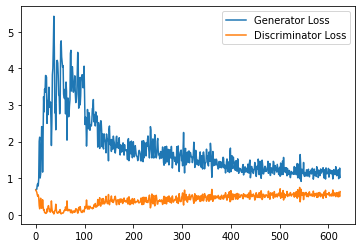

Step 13000: Generator loss: 1.1037654447555543, discriminator loss: 0.5622017223238945


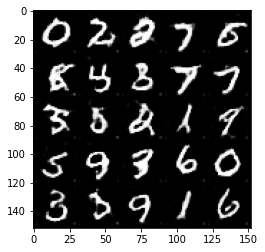

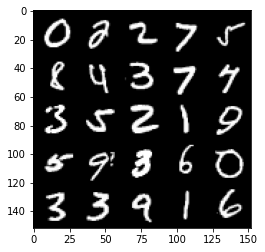

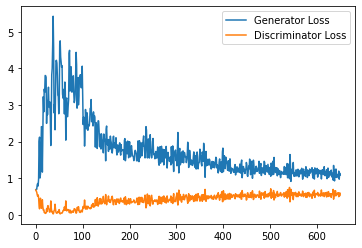

Step 13500: Generator loss: 1.06797134745121, discriminator loss: 0.567383912563324


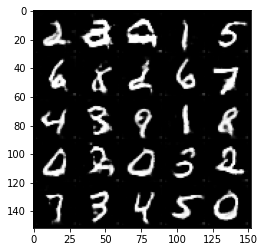

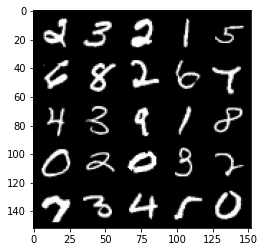

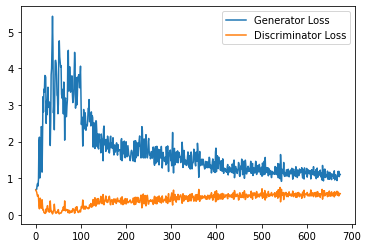

Step 14000: Generator loss: 1.0995291482210159, discriminator loss: 0.5762142775058746


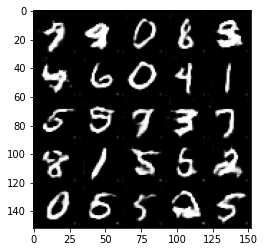

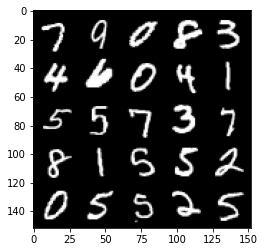

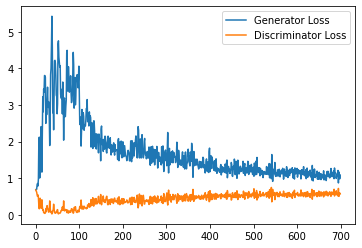

Step 14500: Generator loss: 1.052275247335434, discriminator loss: 0.580503576874733


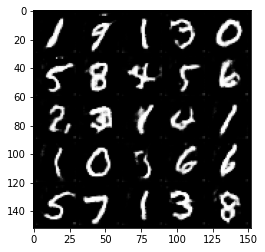

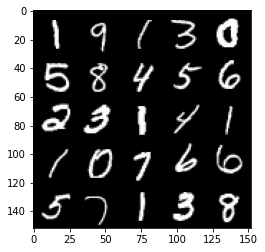

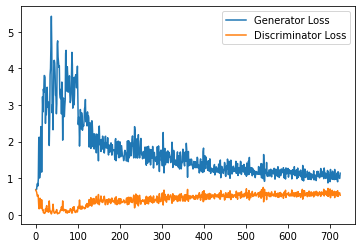

Step 15000: Generator loss: 1.0517893015146256, discriminator loss: 0.5883894408941269


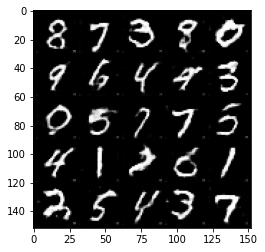

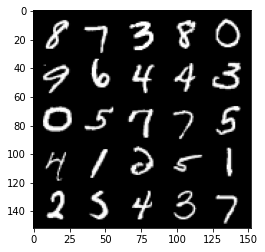

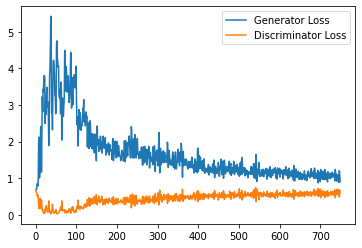

Step 15500: Generator loss: 1.0240449941158294, discriminator loss: 0.591060028553009


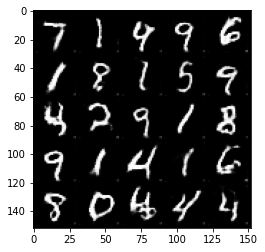

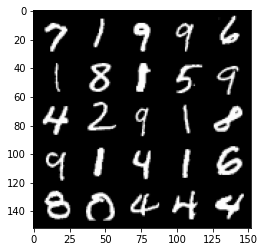

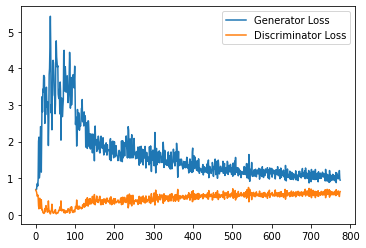

Step 16000: Generator loss: 1.0230222021341324, discriminator loss: 0.596591901242733


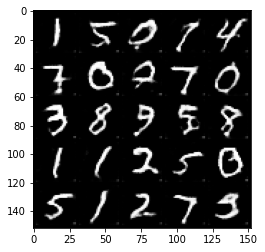

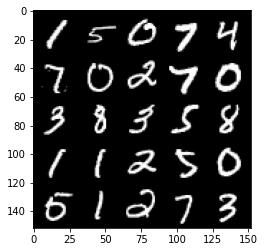

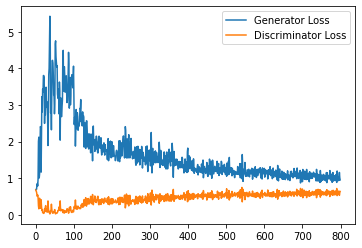

Step 16500: Generator loss: 1.0353458466529846, discriminator loss: 0.5929698507189751


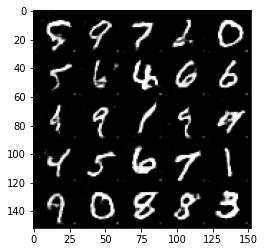

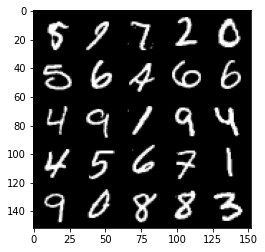

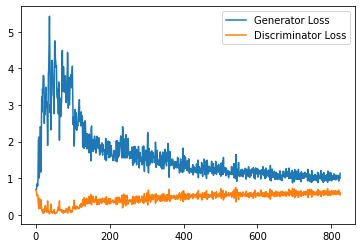

Step 17000: Generator loss: 1.0085881787538529, discriminator loss: 0.6010400165915489


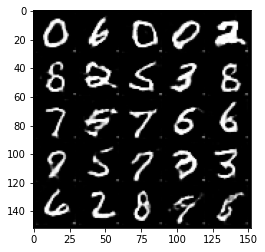

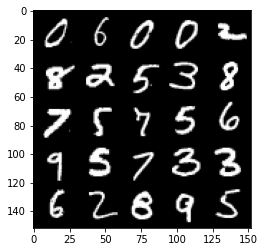

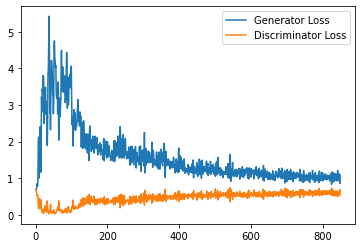

Step 17500: Generator loss: 1.0101005387306214, discriminator loss: 0.5983122983574867


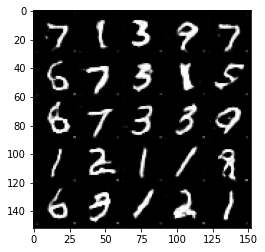

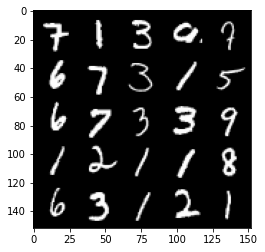

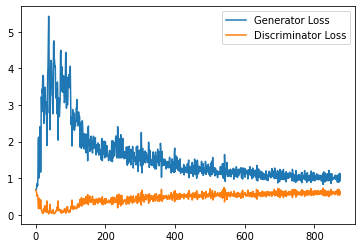

Step 18000: Generator loss: 0.9976222839355469, discriminator loss: 0.6027942474484443


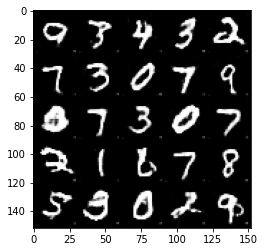

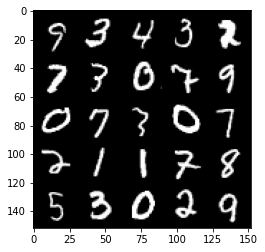

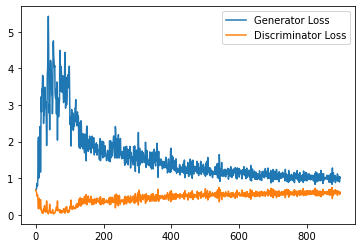

Step 18500: Generator loss: 0.9962395292520523, discriminator loss: 0.6057335047125816


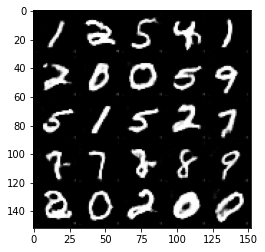

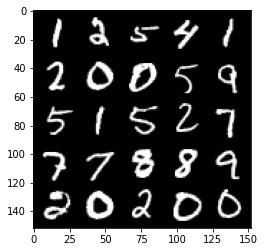

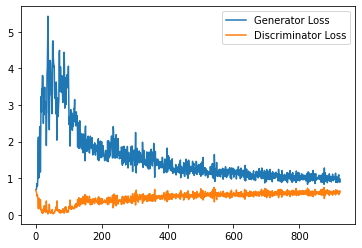

Step 19000: Generator loss: 0.9783802151679992, discriminator loss: 0.6013583602309227


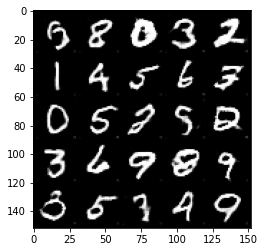

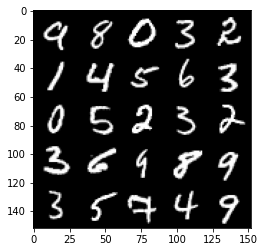

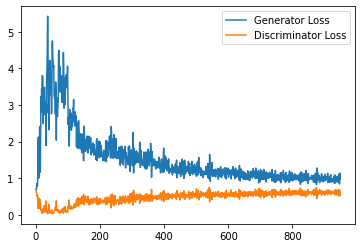

Step 19500: Generator loss: 0.9742540802955627, discriminator loss: 0.6062314792871475


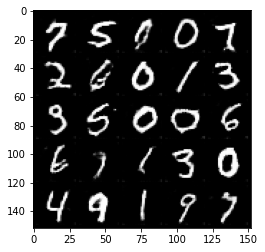

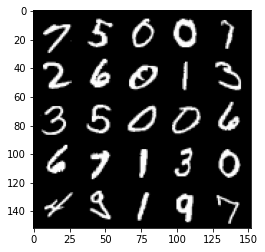

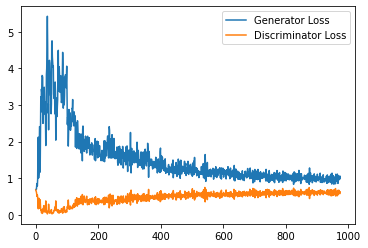

Step 20000: Generator loss: 0.9973261343240738, discriminator loss: 0.6041402526497841


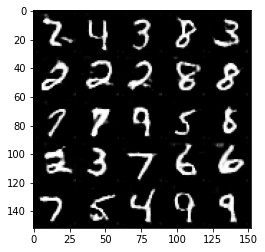

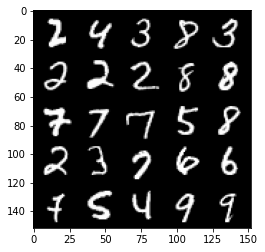

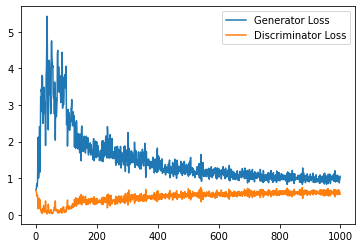

Step 20500: Generator loss: 0.933854630112648, discriminator loss: 0.6081553388834


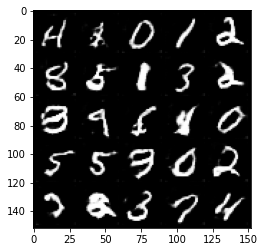

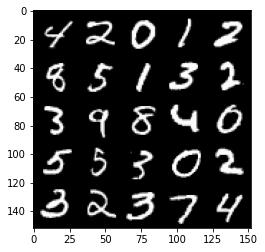

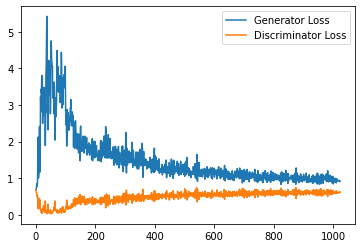

Step 21000: Generator loss: 1.0150632464885712, discriminator loss: 0.603522753417492


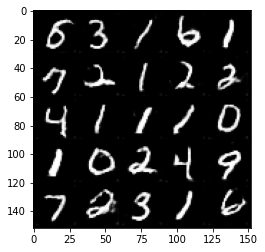

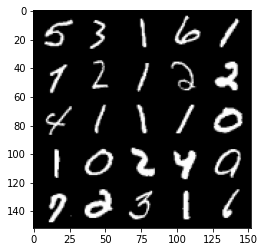

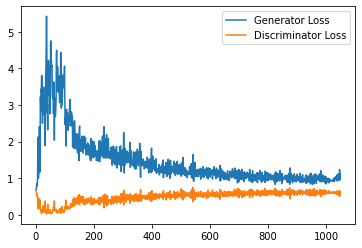

Step 21500: Generator loss: 0.9862332412004471, discriminator loss: 0.608986566722393


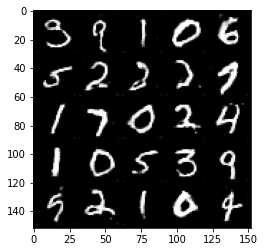

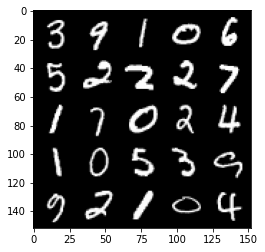

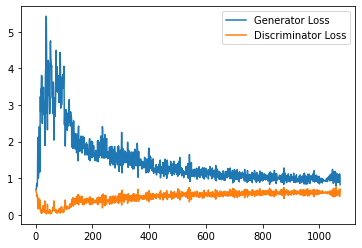

Step 22000: Generator loss: 0.9562651406526566, discriminator loss: 0.606508503973484


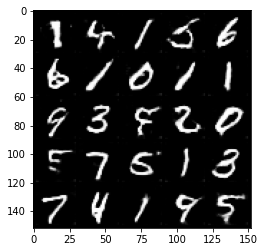

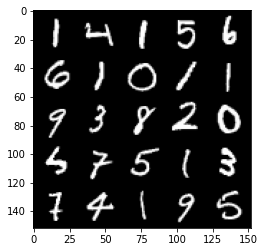

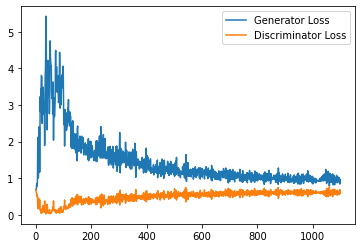

Step 22500: Generator loss: 0.9828562335968017, discriminator loss: 0.6075785692930221


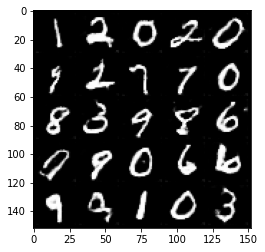

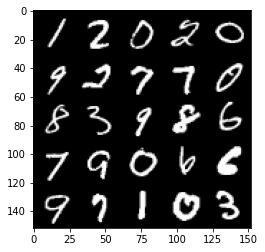

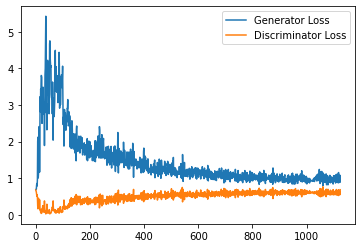

Step 23000: Generator loss: 0.9804249733686448, discriminator loss: 0.6051759873628616


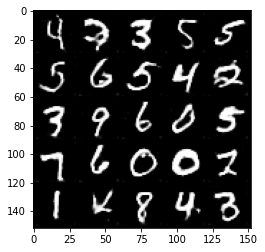

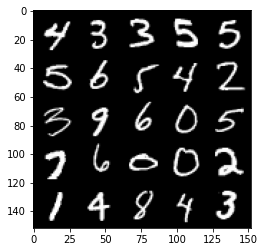

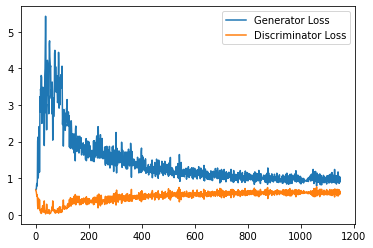

Step 23500: Generator loss: 0.9709696037769318, discriminator loss: 0.6088465900421143


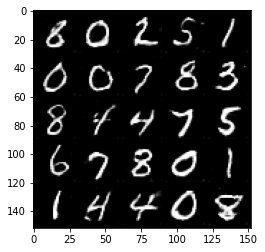

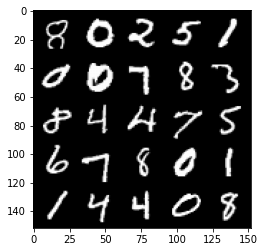

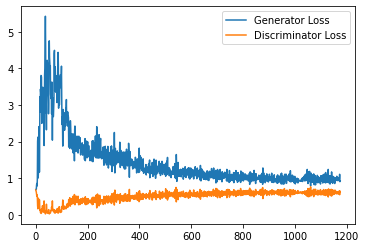

Step 24000: Generator loss: 0.9507681975364685, discriminator loss: 0.6099026339054108


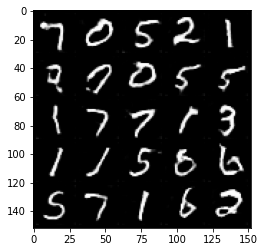

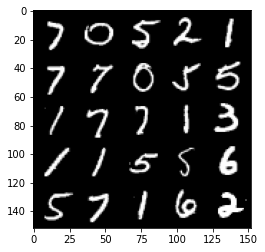

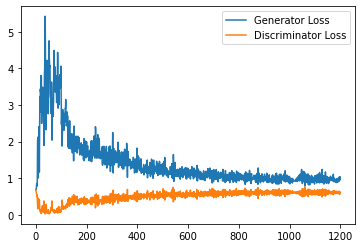

Step 24500: Generator loss: 0.9714457051753997, discriminator loss: 0.6109906324744224


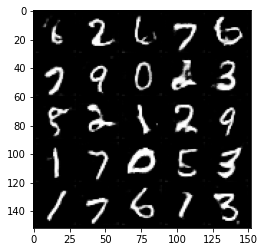

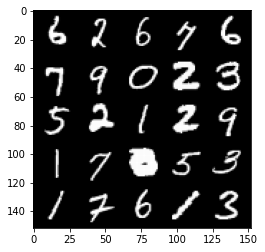

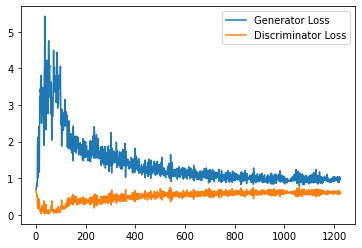

Step 25000: Generator loss: 0.9668456131219864, discriminator loss: 0.6130135022997856


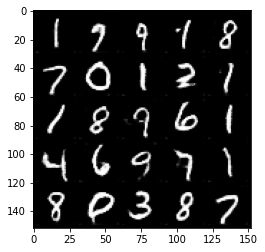

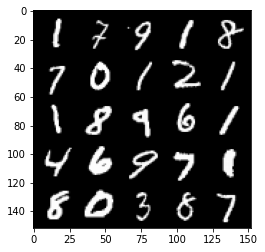

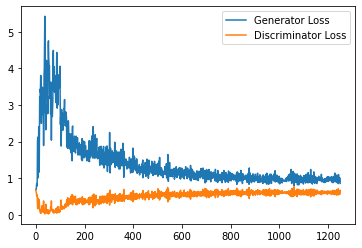

Step 25500: Generator loss: 0.9424070307016372, discriminator loss: 0.6100215793251992


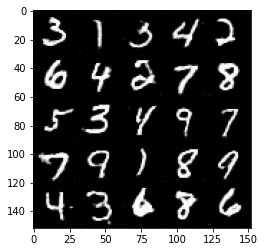

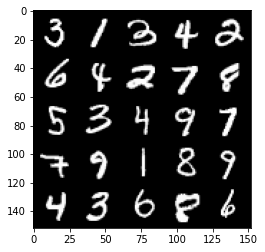

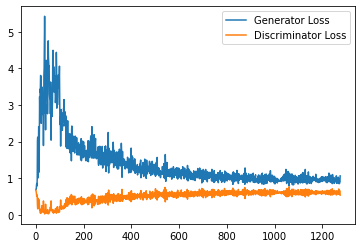

Step 26000: Generator loss: 0.9629568675756455, discriminator loss: 0.6171975235939026


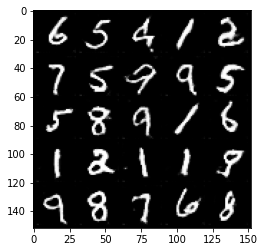

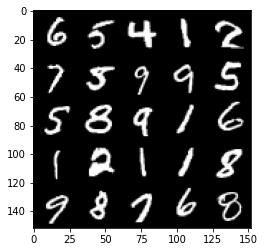

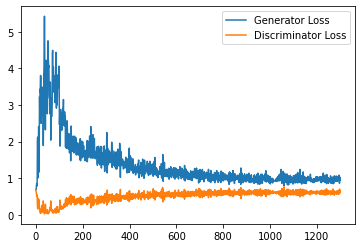

Step 26500: Generator loss: 0.9681962051391602, discriminator loss: 0.6156295854449272


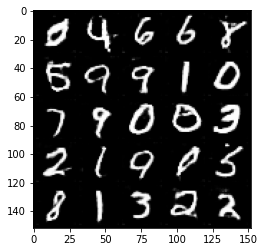

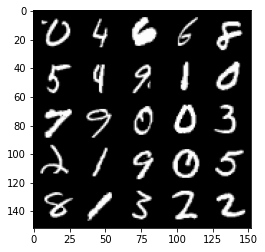

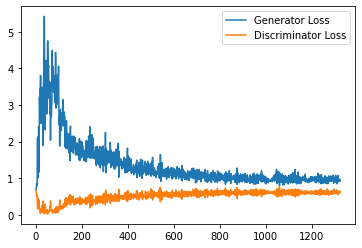

Step 27000: Generator loss: 0.9420231130123139, discriminator loss: 0.6105399873256684


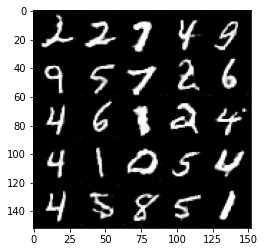

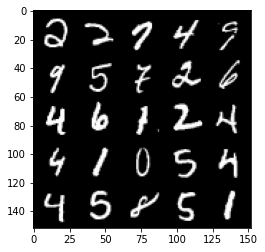

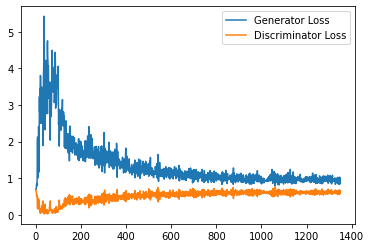

Step 27500: Generator loss: 0.93019391644001, discriminator loss: 0.6131606941819191


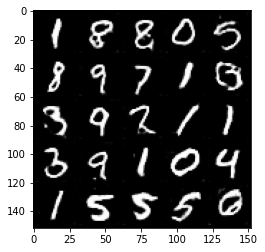

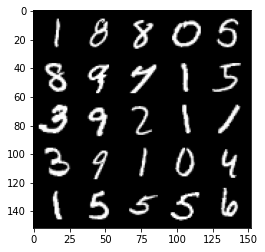

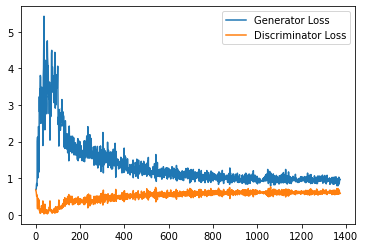

Step 28000: Generator loss: 0.9285140616893768, discriminator loss: 0.6176168591380119


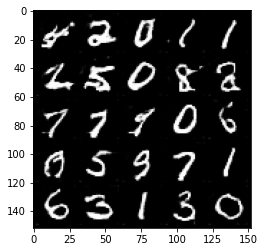

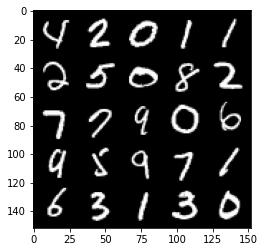

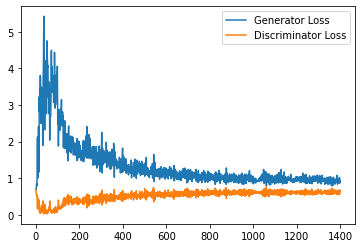

Step 28500: Generator loss: 0.9569931777715683, discriminator loss: 0.6121706600785255


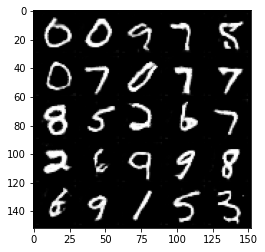

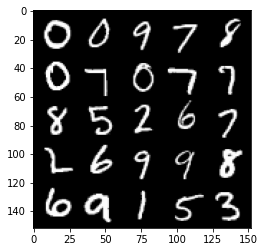

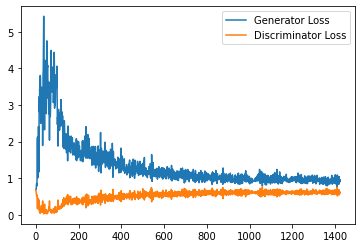

Step 29000: Generator loss: 0.9459545663595199, discriminator loss: 0.6148176792263985


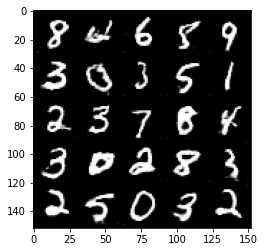

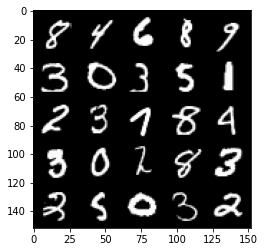

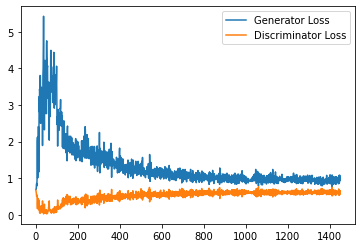

Step 29500: Generator loss: 0.9453839911222458, discriminator loss: 0.6115766305923462


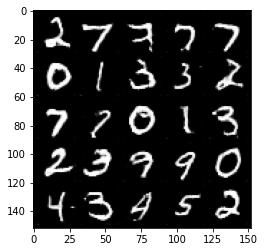

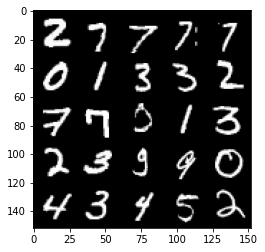

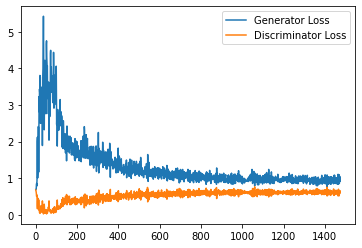

Step 30000: Generator loss: 0.9431362260580063, discriminator loss: 0.6162765334844589


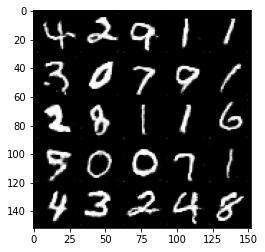

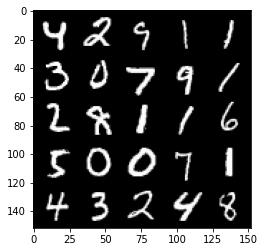

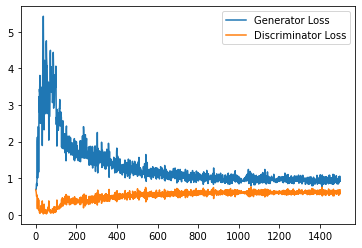

Step 30500: Generator loss: 0.9691866592168809, discriminator loss: 0.6106953255534172


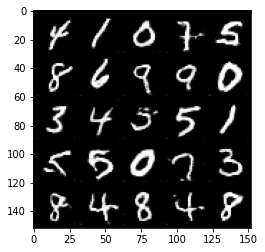

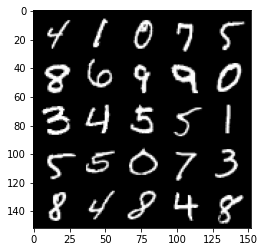

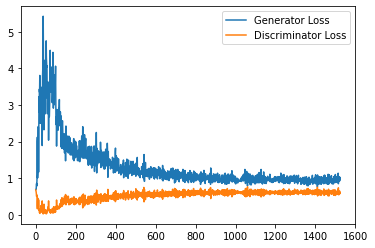

Step 31000: Generator loss: 0.9710554386377335, discriminator loss: 0.6154917233586311


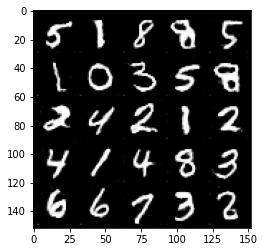

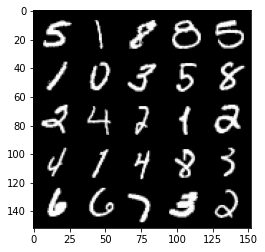

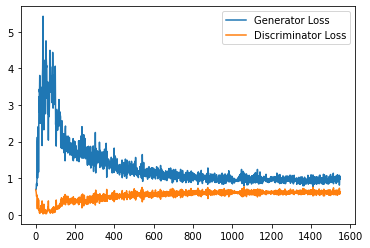

Step 31500: Generator loss: 0.9453035371303559, discriminator loss: 0.6151623227596283


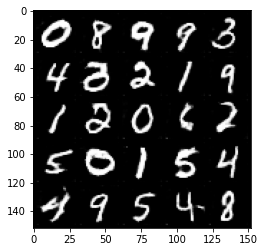

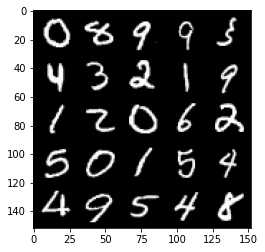

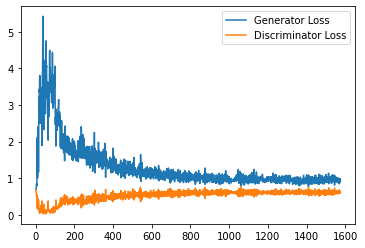

Step 32000: Generator loss: 0.918593507528305, discriminator loss: 0.6147775157690049


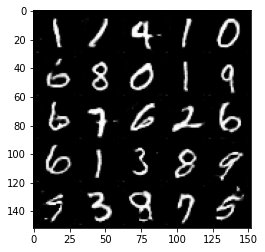

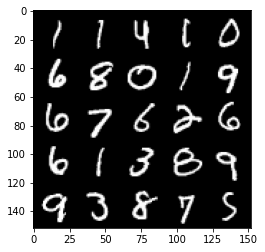

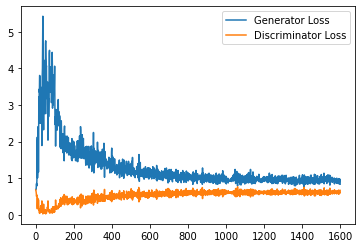

Step 32500: Generator loss: 0.9298540478944779, discriminator loss: 0.6143922700881957


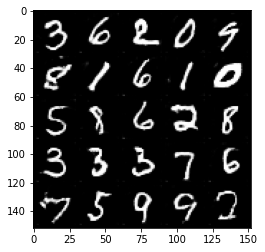

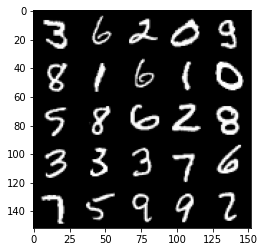

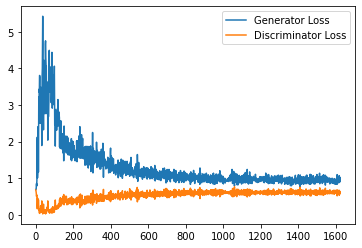

Step 33000: Generator loss: 0.9429836783409119, discriminator loss: 0.6194366735816002


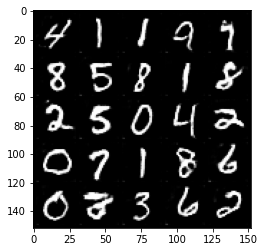

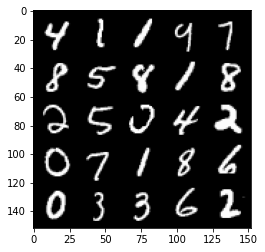

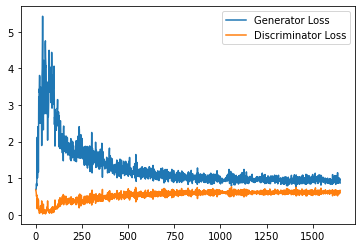

Step 33500: Generator loss: 0.9324836249351501, discriminator loss: 0.6122023549079895


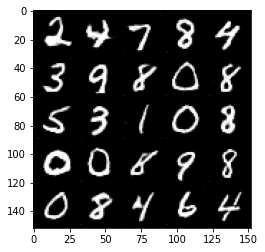

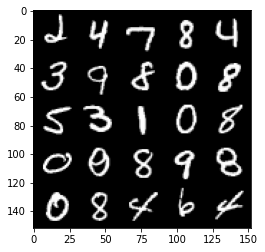

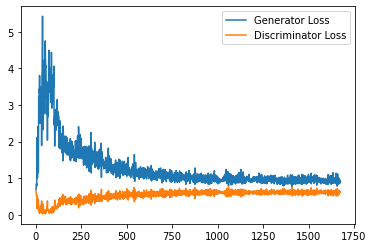

Step 34000: Generator loss: 0.9346837400197983, discriminator loss: 0.6136191210150719


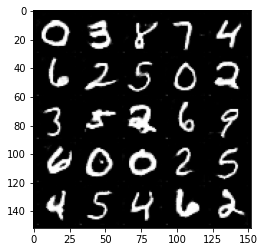

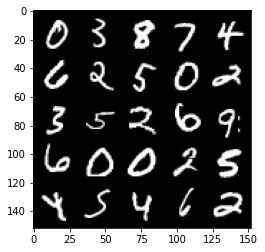

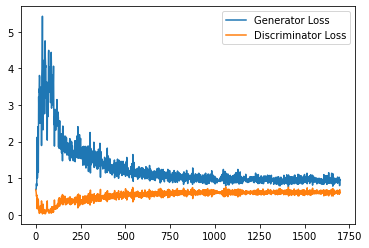

Step 34500: Generator loss: 0.9422854803800583, discriminator loss: 0.6099839931726456


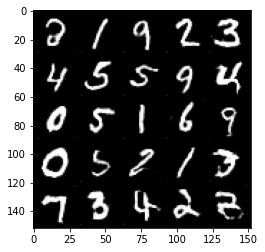

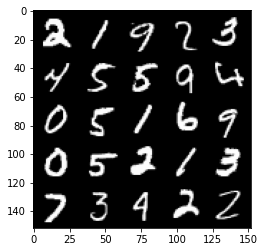

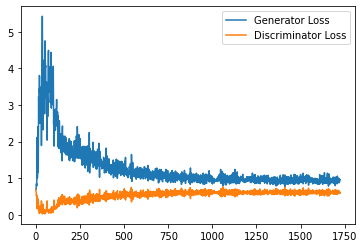

Step 35000: Generator loss: 0.9423962061405182, discriminator loss: 0.616500462949276


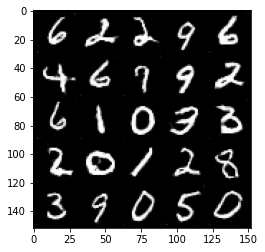

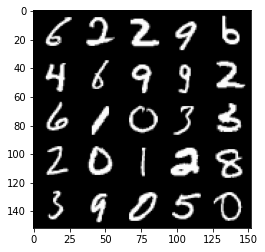

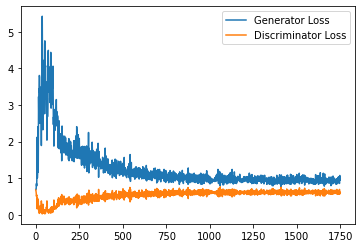

Step 35500: Generator loss: 0.9535980610847473, discriminator loss: 0.6155784600973129


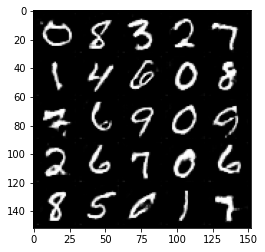

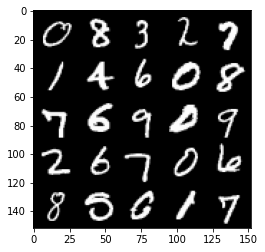

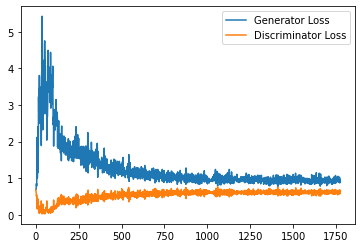

Step 36000: Generator loss: 0.9400518420934677, discriminator loss: 0.6143279775381089


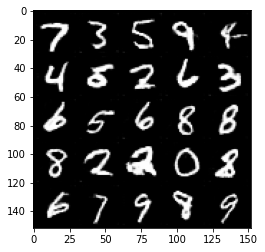

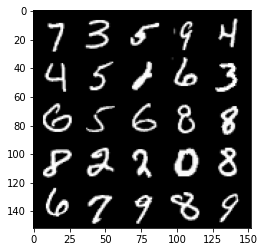

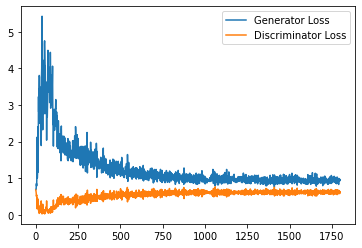

Step 36500: Generator loss: 0.92972796022892, discriminator loss: 0.6135413884520531


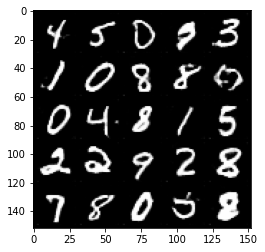

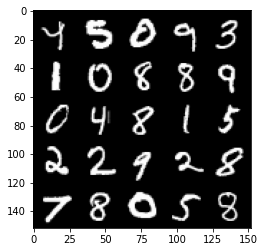

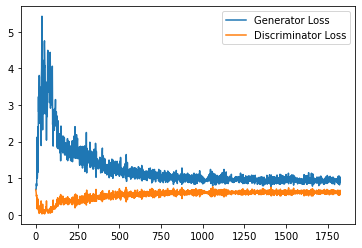

Step 37000: Generator loss: 0.9440537639856339, discriminator loss: 0.6113876966238022


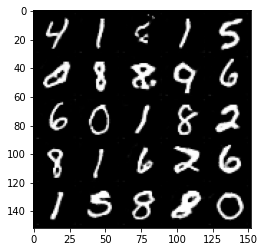

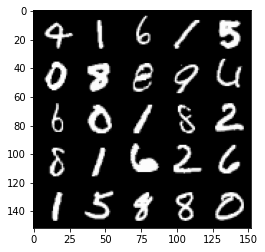

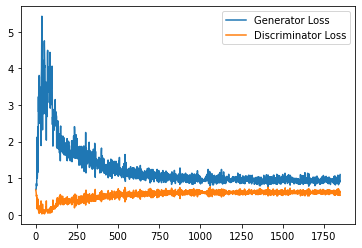

Step 37500: Generator loss: 0.9502986952066421, discriminator loss: 0.6200125766992569


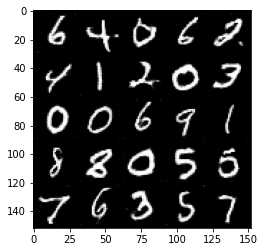

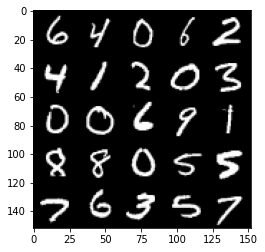

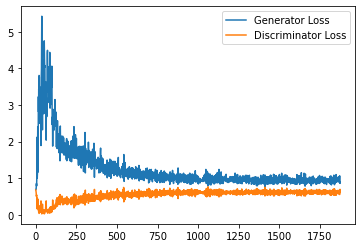

Step 38000: Generator loss: 0.9354518083333969, discriminator loss: 0.6130271002054214


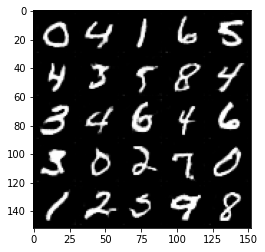

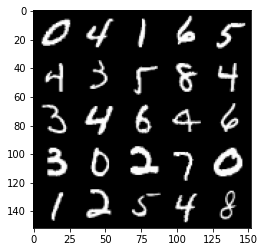

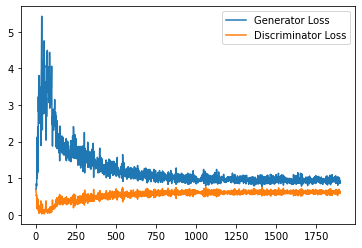

Step 38500: Generator loss: 0.9284804310798646, discriminator loss: 0.6151754597425461


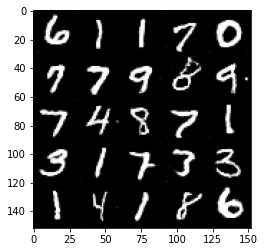

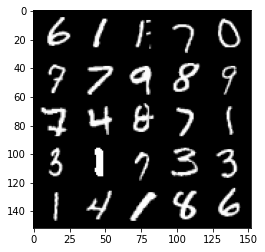

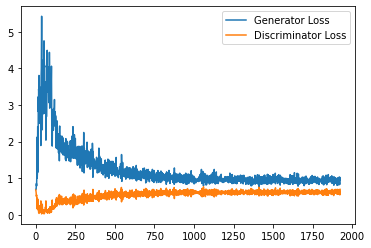

Step 39000: Generator loss: 0.9406653100252151, discriminator loss: 0.6138467431068421


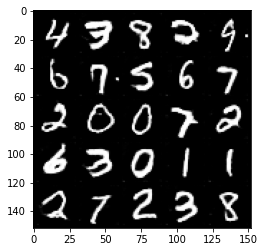

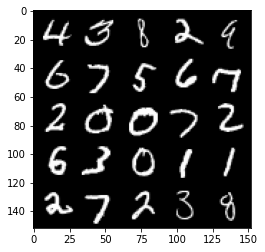

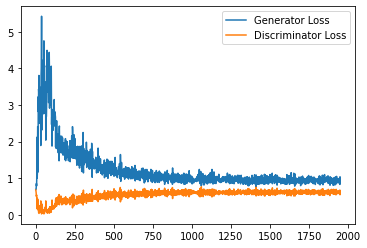

Step 39500: Generator loss: 0.9229790805578232, discriminator loss: 0.6142215087413788


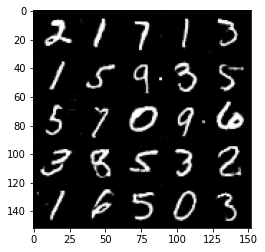

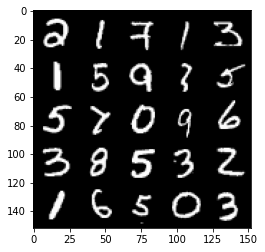

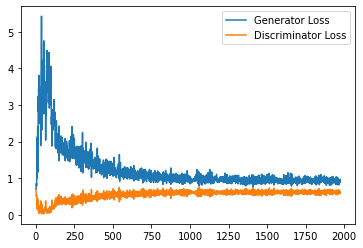

Step 40000: Generator loss: 0.9360733432769776, discriminator loss: 0.6144196727275848


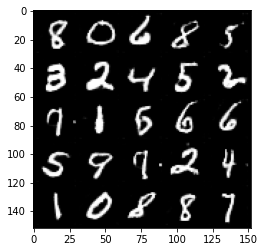

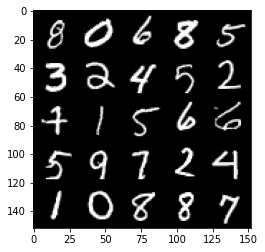

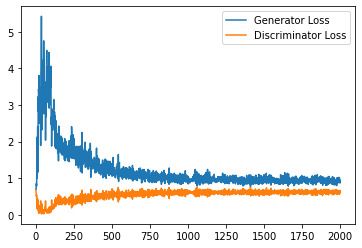

Step 40500: Generator loss: 0.9353491431474685, discriminator loss: 0.6134682924747467


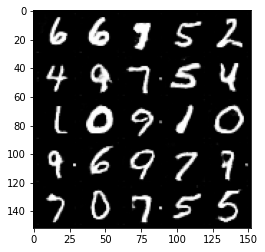

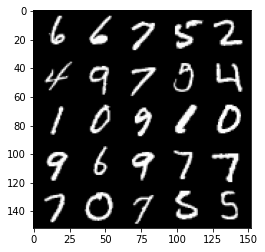

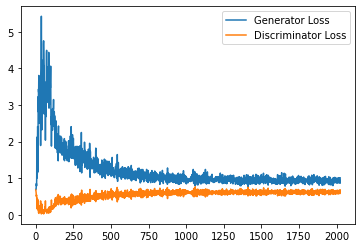

Step 41000: Generator loss: 0.9260565513372421, discriminator loss: 0.6134994677901268


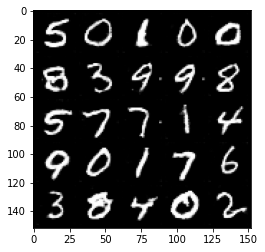

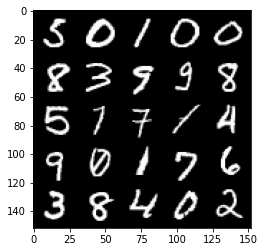

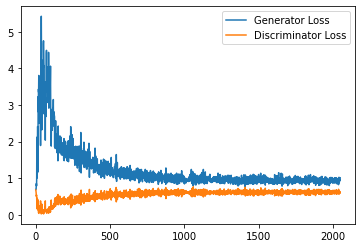

Step 41500: Generator loss: 0.9341905429363251, discriminator loss: 0.6170549402832985


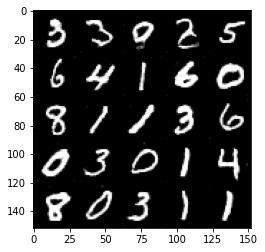

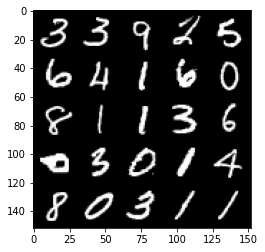

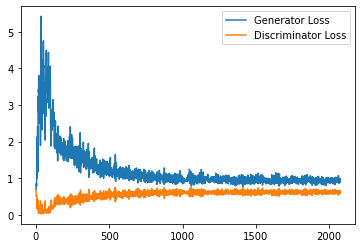

Step 42000: Generator loss: 0.9412592853307724, discriminator loss: 0.6106177296638489


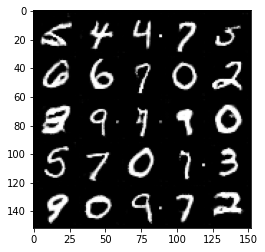

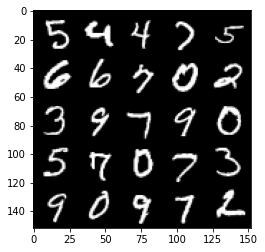

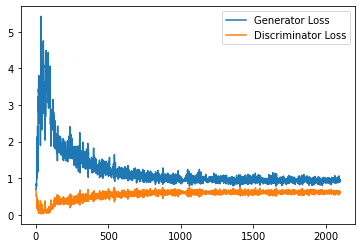

Step 42500: Generator loss: 0.9349009730815887, discriminator loss: 0.6125805796384811


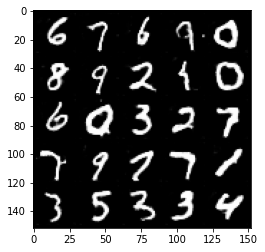

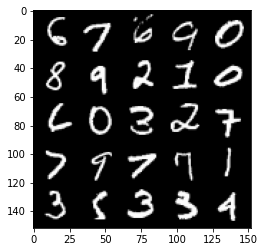

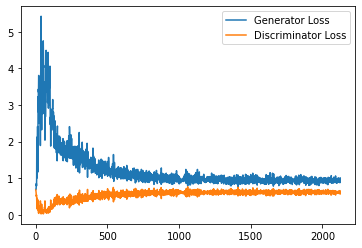

Step 43000: Generator loss: 0.9395510590076447, discriminator loss: 0.6144822776317597


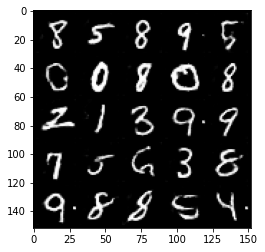

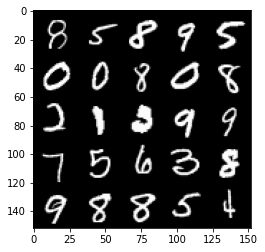

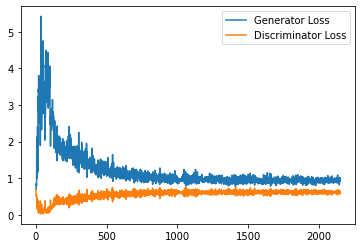

Step 43500: Generator loss: 0.9274955441951752, discriminator loss: 0.6138356142044067


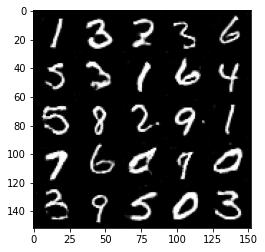

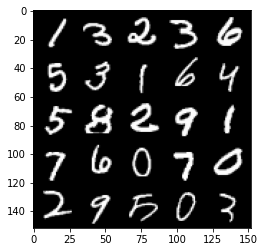

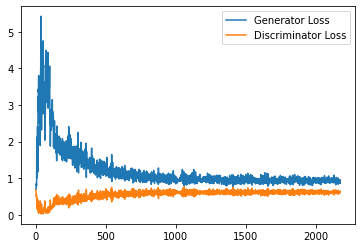

Step 44000: Generator loss: 0.9343882248401641, discriminator loss: 0.6141936500072479


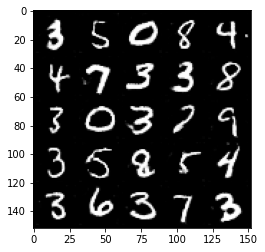

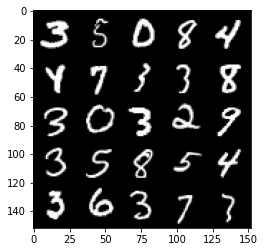

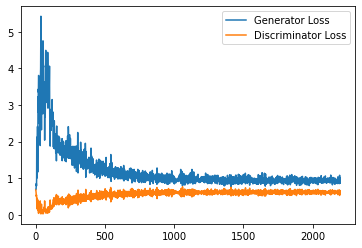

Step 44500: Generator loss: 0.9260873726606369, discriminator loss: 0.6146208053231239


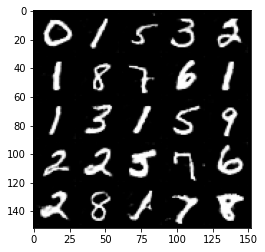

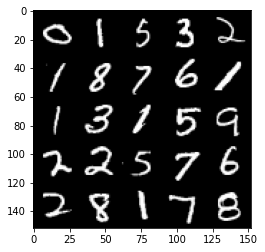

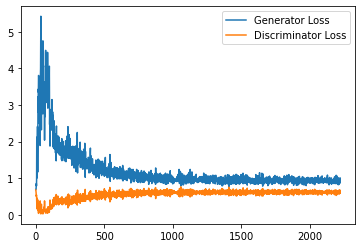

Step 45000: Generator loss: 0.9336369099617005, discriminator loss: 0.6086651779413224


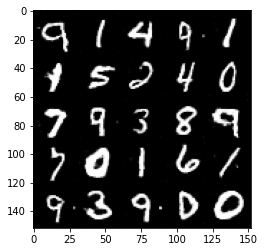

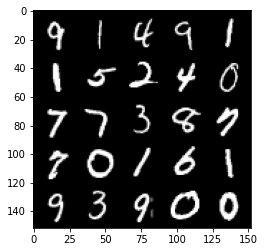

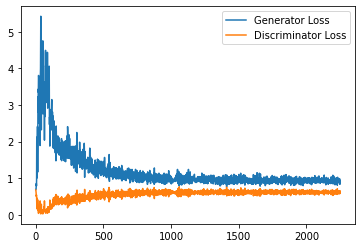

Step 45500: Generator loss: 0.9389679301977157, discriminator loss: 0.6126128417849541


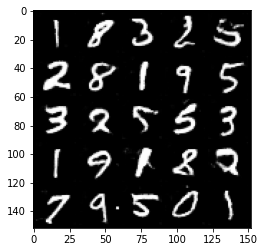

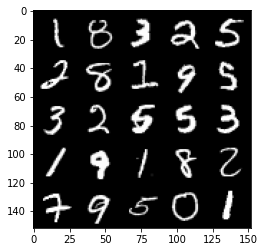

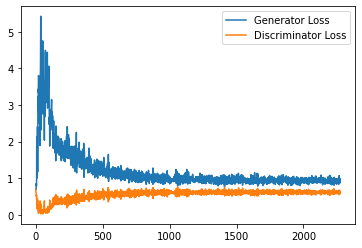

Step 46000: Generator loss: 0.9324983506202698, discriminator loss: 0.6133683922290802


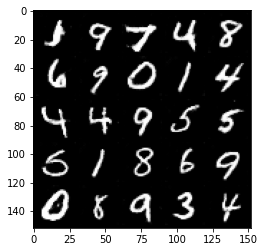

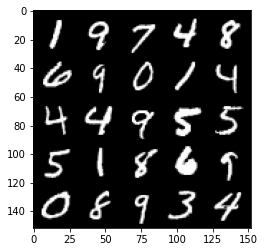

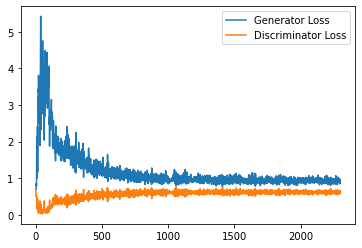

Step 46500: Generator loss: 0.9398670151233673, discriminator loss: 0.610289889395237


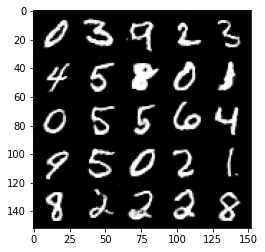

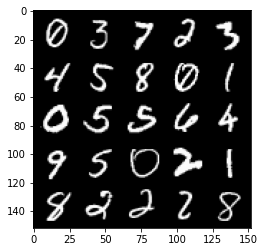

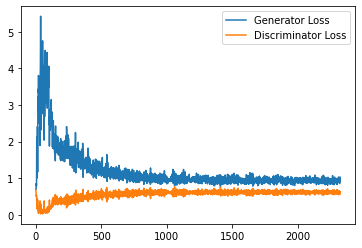

Step 47000: Generator loss: 0.9327900742292404, discriminator loss: 0.611641713142395


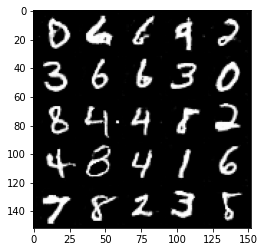

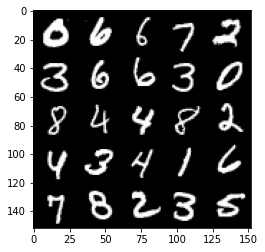

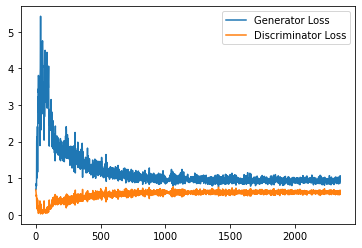

Step 47500: Generator loss: 0.9341622079610825, discriminator loss: 0.611177574813366


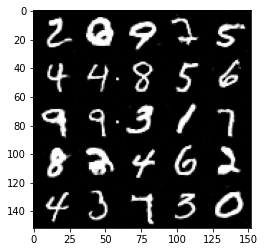

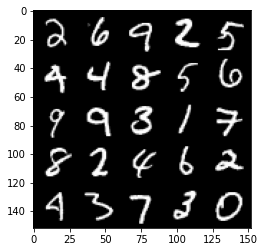

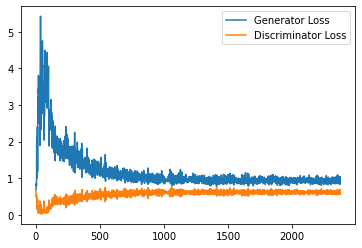

Step 48000: Generator loss: 0.9418273458480835, discriminator loss: 0.611480363368988


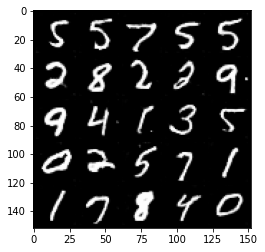

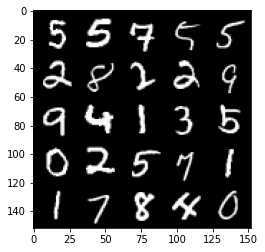

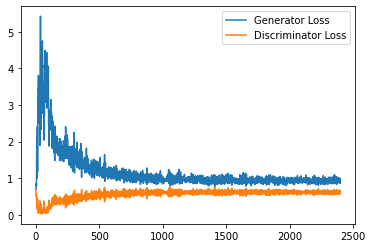

Step 48500: Generator loss: 0.9448438118696213, discriminator loss: 0.6132866661548615


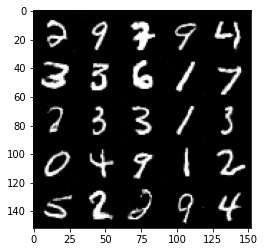

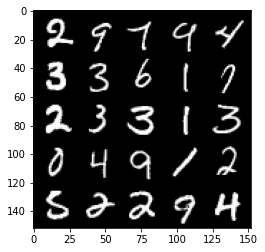

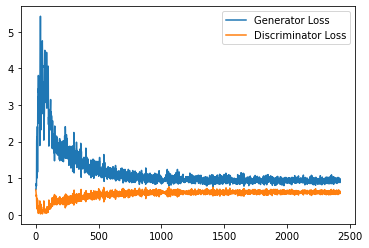

Step 49000: Generator loss: 0.9432425198554992, discriminator loss: 0.6103743282556534


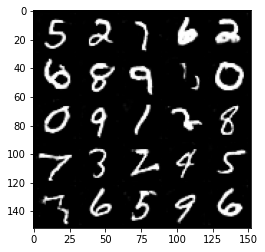

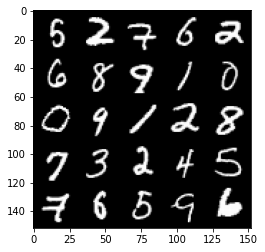

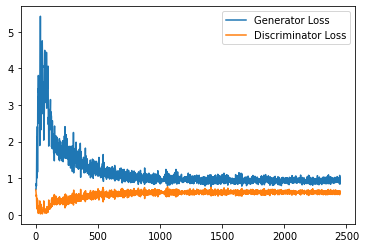

Step 49500: Generator loss: 0.9410439363718033, discriminator loss: 0.6079590971469879


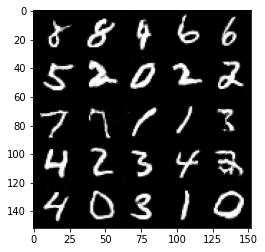

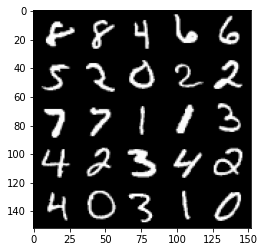

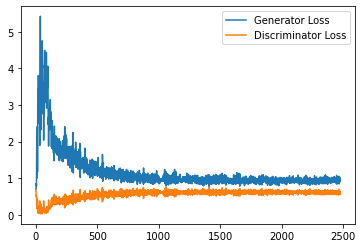

Step 50000: Generator loss: 0.9424630868434906, discriminator loss: 0.6166722903251648


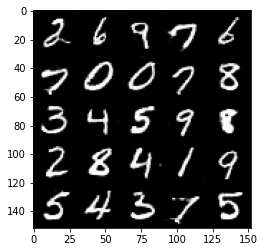

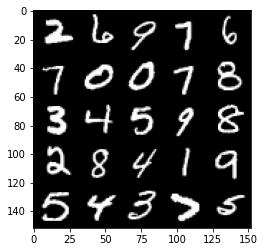

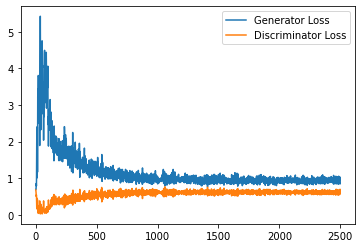

Step 50500: Generator loss: 0.9486561739444732, discriminator loss: 0.6117104079723358


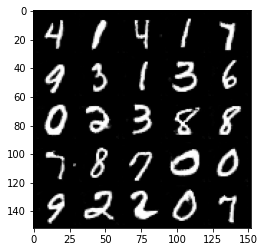

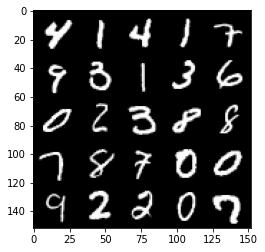

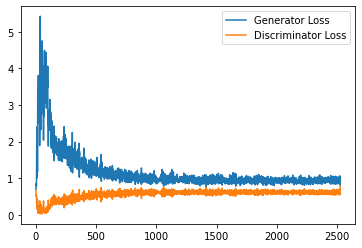

Step 51000: Generator loss: 0.9591521557569503, discriminator loss: 0.6054467918276787


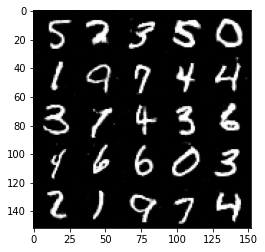

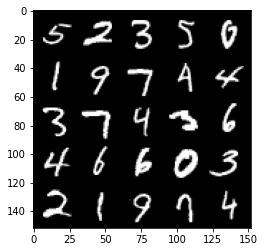

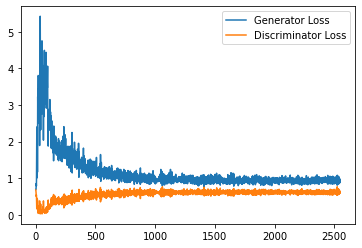

Step 51500: Generator loss: 0.9576770079135895, discriminator loss: 0.6063285779356956


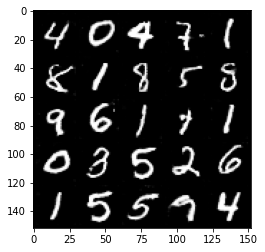

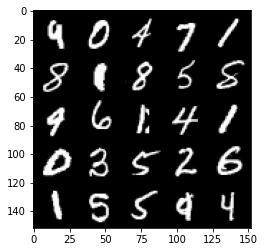

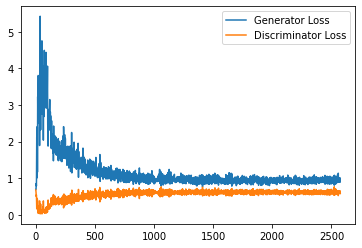

Step 52000: Generator loss: 0.9489562200307846, discriminator loss: 0.6076660110354424


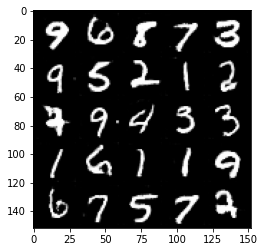

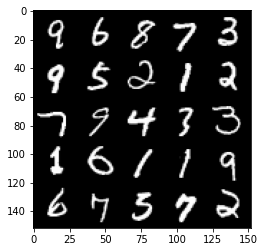

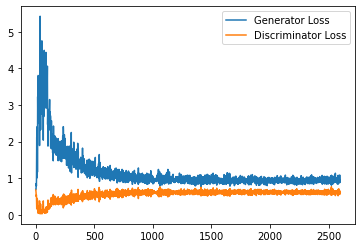

Step 52500: Generator loss: 0.9526362516880036, discriminator loss: 0.6058977826237678


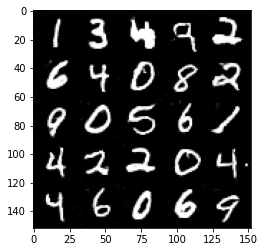

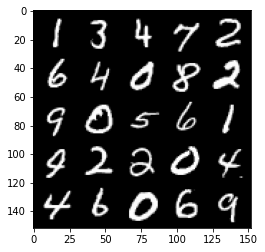

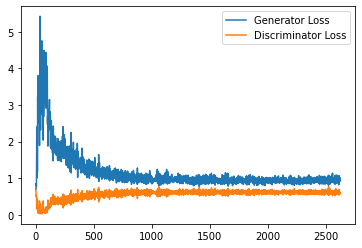

Step 53000: Generator loss: 0.9436887032985687, discriminator loss: 0.6126071878671646


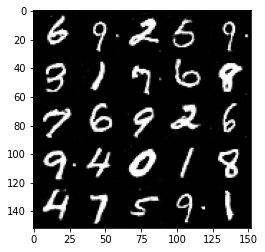

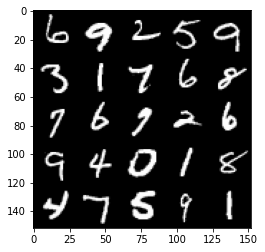

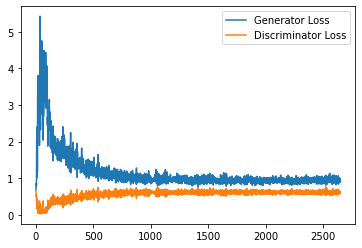

Step 53500: Generator loss: 0.9596040222644806, discriminator loss: 0.6091179879903793


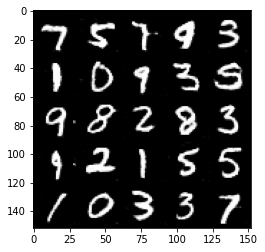

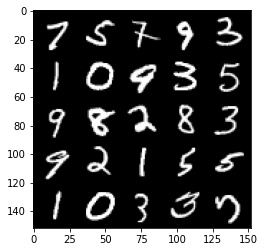

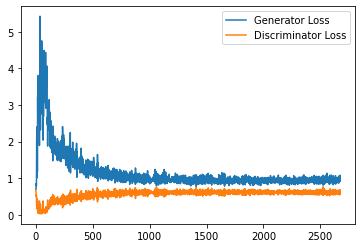

Step 54000: Generator loss: 0.9595459240674973, discriminator loss: 0.6075297560691834


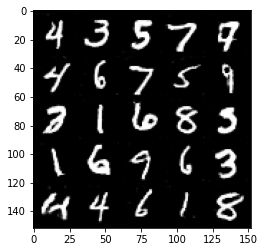

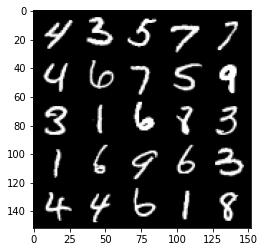

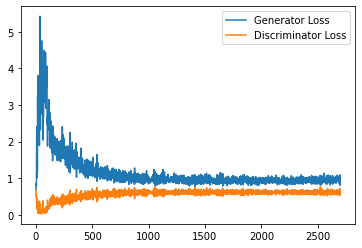

Step 54500: Generator loss: 0.936188067317009, discriminator loss: 0.609986110150814


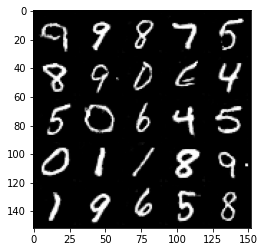

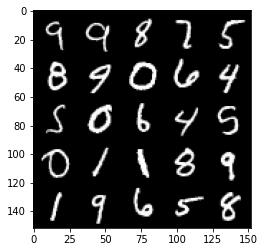

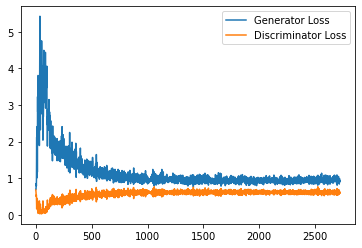

Step 55000: Generator loss: 0.9598490097522736, discriminator loss: 0.6027455888390542


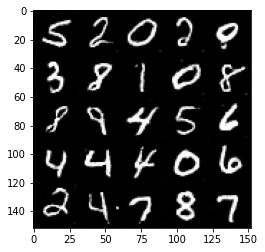

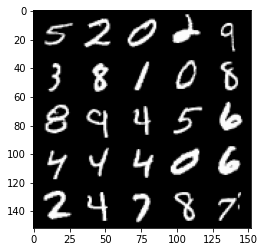

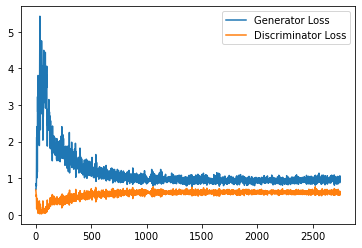

Step 55500: Generator loss: 0.9428826470375061, discriminator loss: 0.6082762195467949


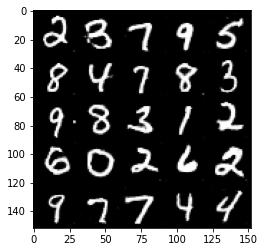

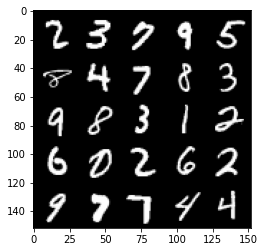

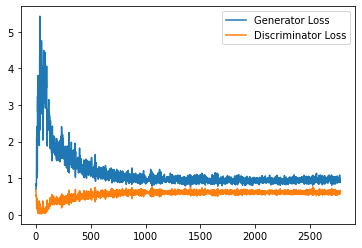

Step 56000: Generator loss: 0.9574214704036713, discriminator loss: 0.6037979416847229


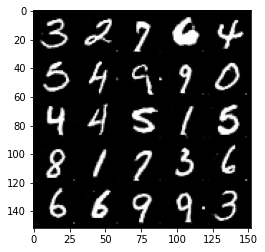

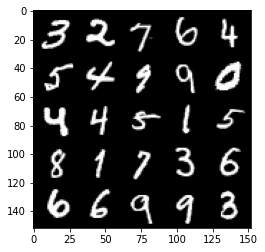

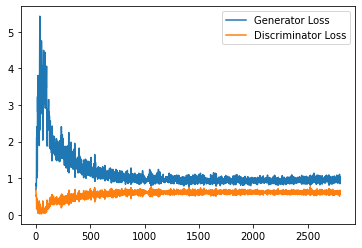

Step 56500: Generator loss: 0.9665368436574936, discriminator loss: 0.6038976328372956


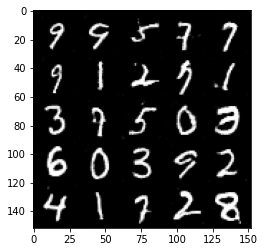

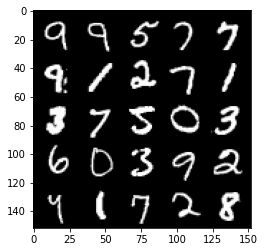

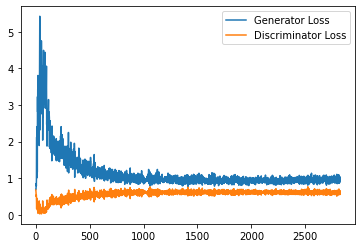

Step 57000: Generator loss: 0.9569013600349426, discriminator loss: 0.6018356242179871


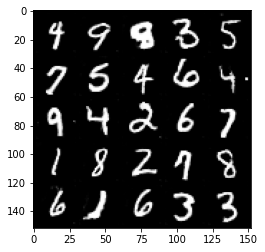

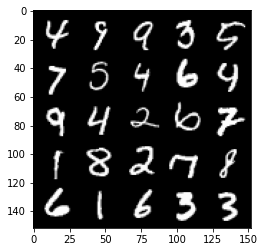

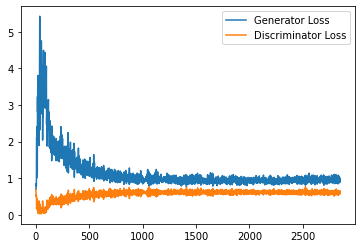

Step 57500: Generator loss: 0.9494124989509583, discriminator loss: 0.6069114339947701


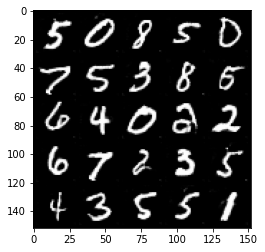

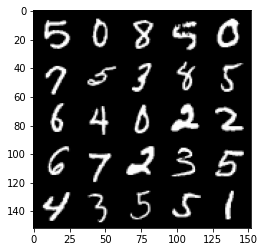

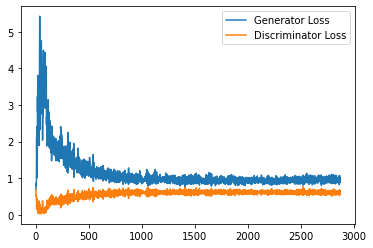

Step 58000: Generator loss: 0.9603774538040161, discriminator loss: 0.5992605985999108


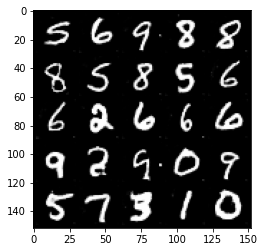

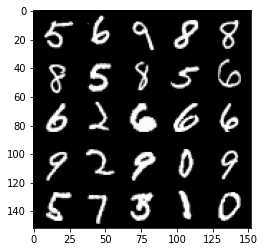

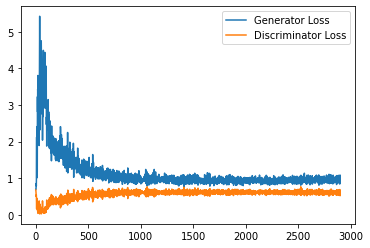

Step 58500: Generator loss: 0.9566407470703125, discriminator loss: 0.6048746849298478


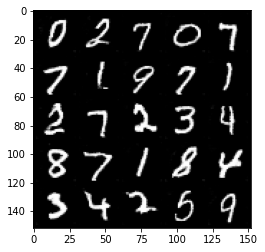

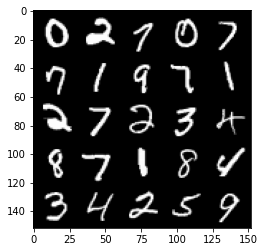

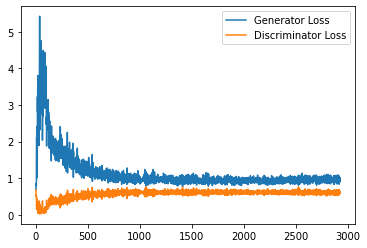

Step 59000: Generator loss: 0.9643581607341767, discriminator loss: 0.60287665194273


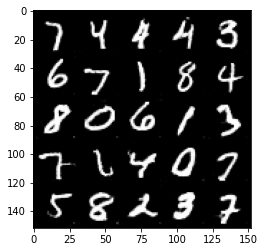

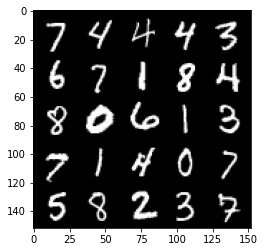

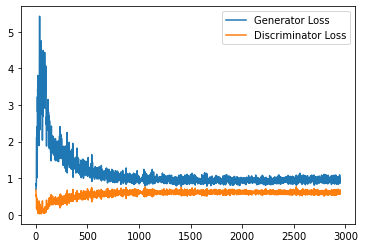

Step 59500: Generator loss: 0.9502235367298126, discriminator loss: 0.6029212186932564


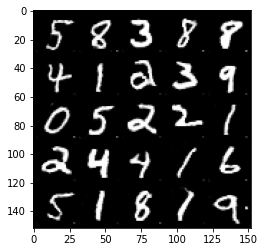

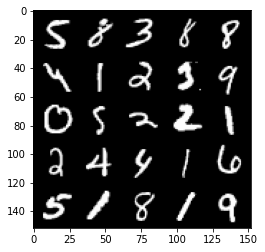

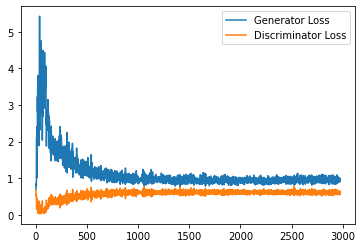

Step 60000: Generator loss: 0.9786923340559006, discriminator loss: 0.5973048680424691


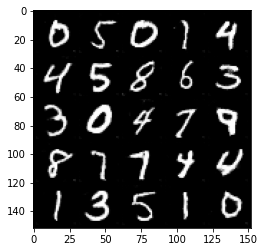

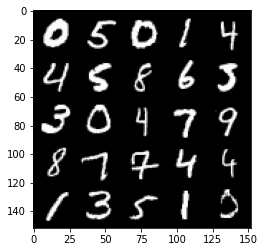

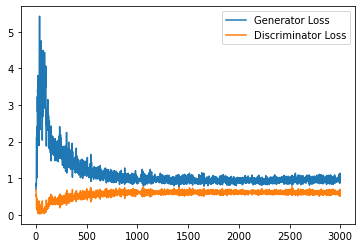

Step 60500: Generator loss: 0.9644028229713439, discriminator loss: 0.6030994362831116


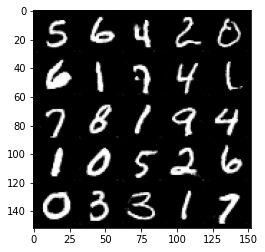

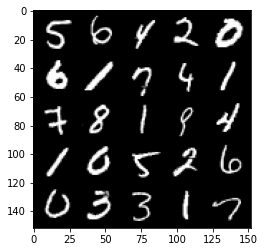

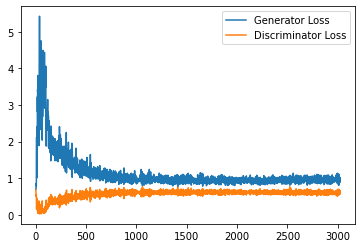

Step 61000: Generator loss: 0.9680990303754806, discriminator loss: 0.5985288300514221


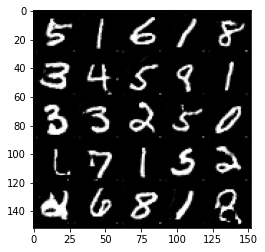

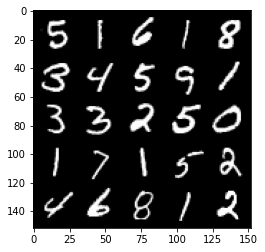

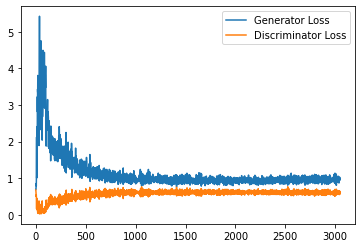

Step 61500: Generator loss: 0.969542426943779, discriminator loss: 0.6011712601780892


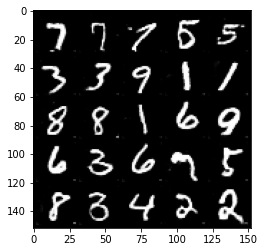

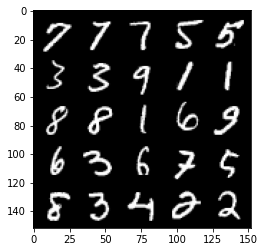

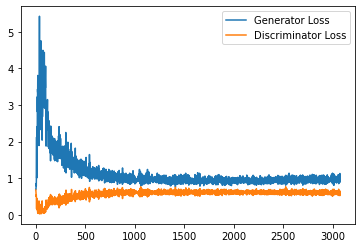

Step 62000: Generator loss: 0.9555503207445145, discriminator loss: 0.5976293858289718


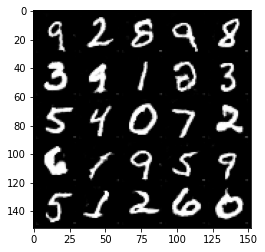

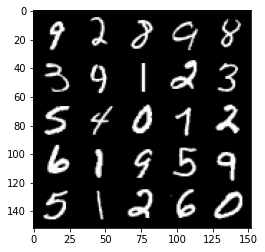

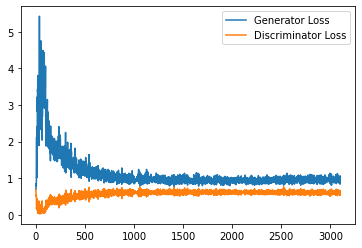

Step 62500: Generator loss: 0.9667061870098114, discriminator loss: 0.5984225904345513


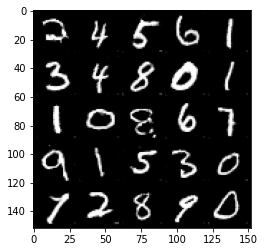

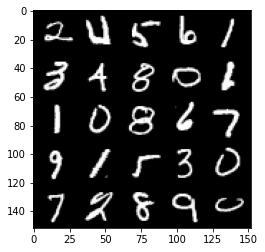

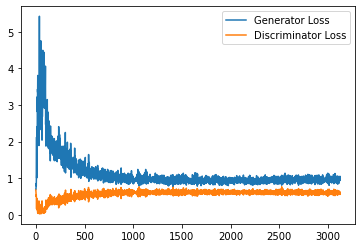

Step 63000: Generator loss: 0.9587644523382187, discriminator loss: 0.6092011077404023


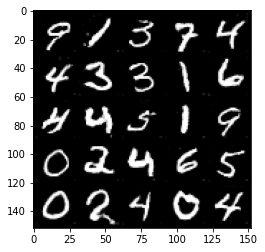

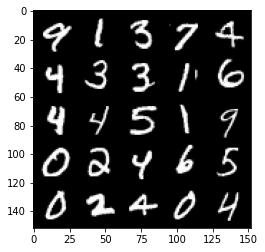

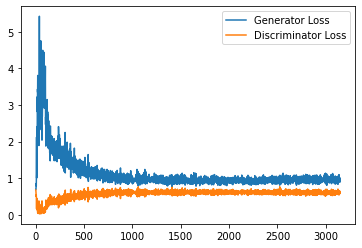

Step 63500: Generator loss: 0.9714351671934128, discriminator loss: 0.5984695511460304


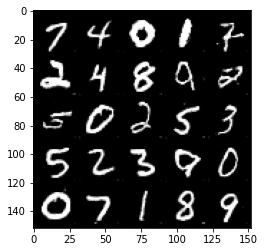

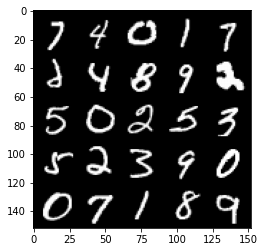

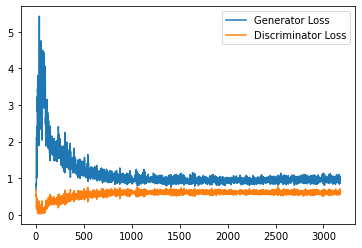

Step 64000: Generator loss: 0.976655130982399, discriminator loss: 0.6044506050348282


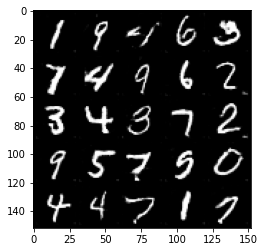

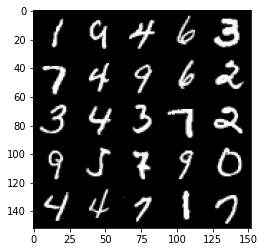

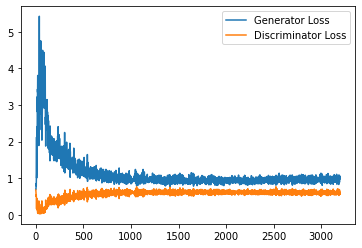

Step 64500: Generator loss: 0.9754095422029495, discriminator loss: 0.6059360036253929


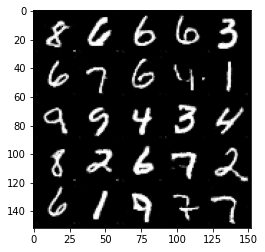

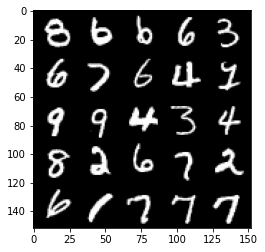

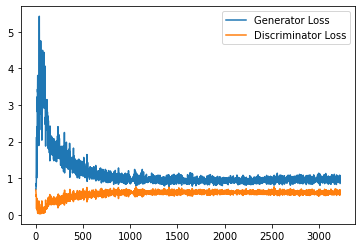

Step 65000: Generator loss: 0.9638637474775315, discriminator loss: 0.5975156720280648


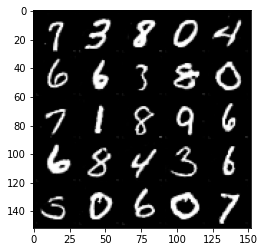

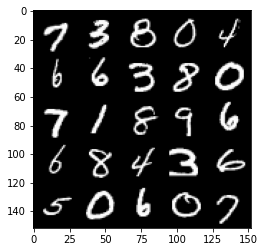

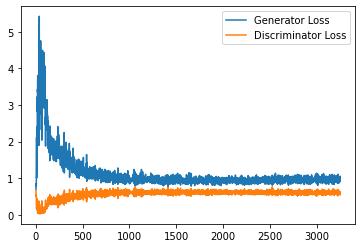

Step 65500: Generator loss: 0.9625249083042144, discriminator loss: 0.6064961960315705


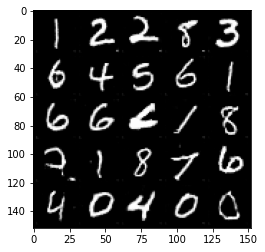

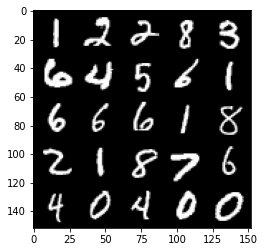

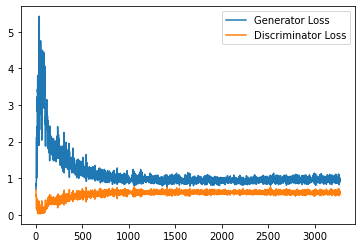

Step 66000: Generator loss: 0.9675160034894943, discriminator loss: 0.6037043028473854


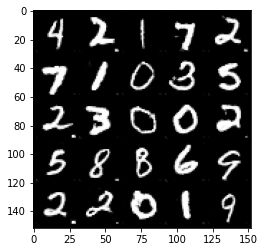

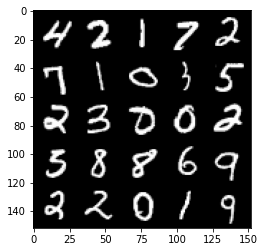

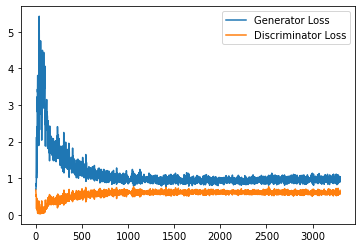

Step 66500: Generator loss: 0.9721346064805985, discriminator loss: 0.6031291762590408


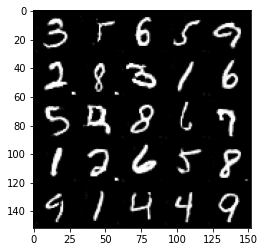

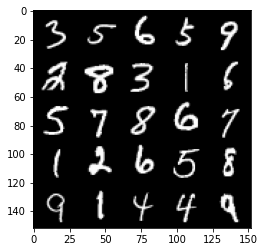

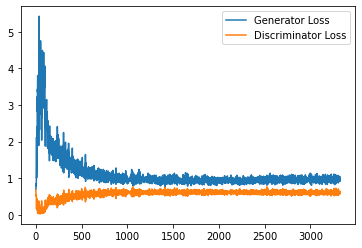

Step 67000: Generator loss: 0.9627860910892486, discriminator loss: 0.6031790121197701


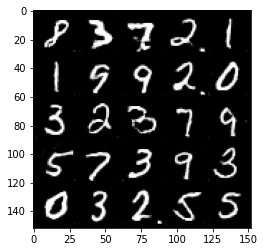

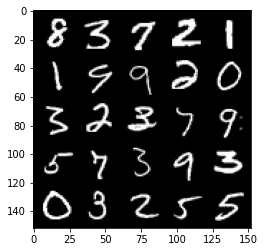

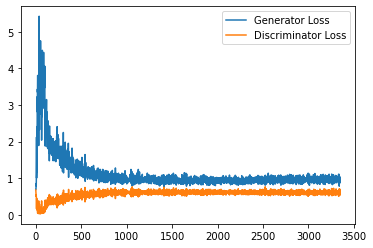

Step 67500: Generator loss: 0.9672273441553115, discriminator loss: 0.6035326489806175


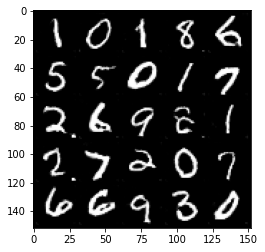

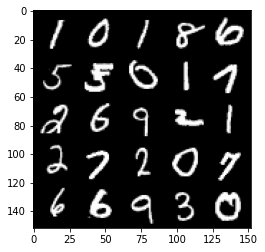

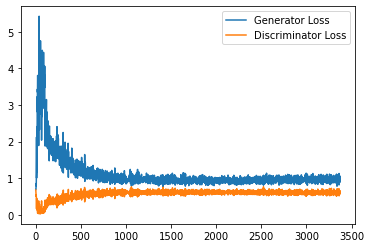

Step 68000: Generator loss: 0.9731119734048843, discriminator loss: 0.6037767869234085


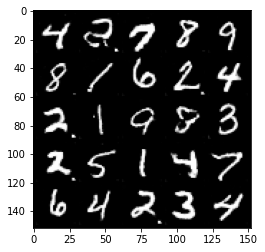

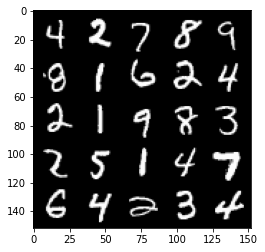

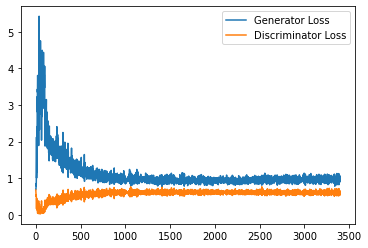

Step 68500: Generator loss: 0.9777114055156708, discriminator loss: 0.599175123333931


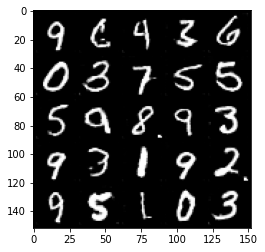

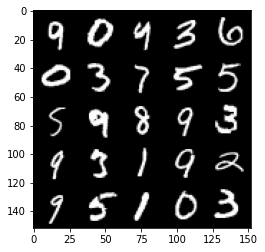

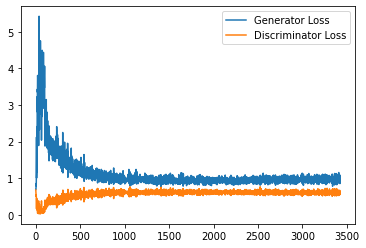

Step 69000: Generator loss: 0.9755243489742279, discriminator loss: 0.6027736476063729


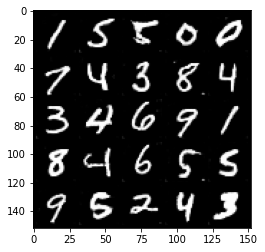

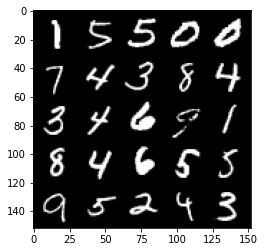

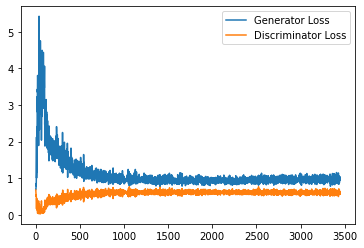

Step 69500: Generator loss: 0.9601801937818527, discriminator loss: 0.6030197841525078


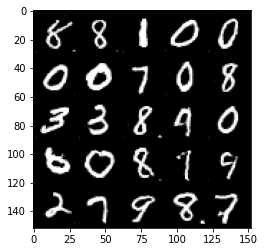

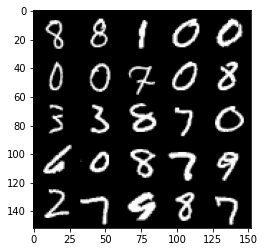

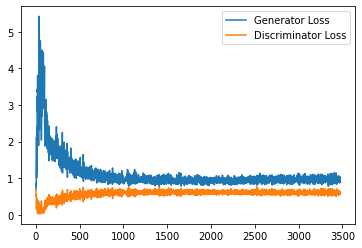

Step 70000: Generator loss: 0.9686988098621369, discriminator loss: 0.6058609486818314


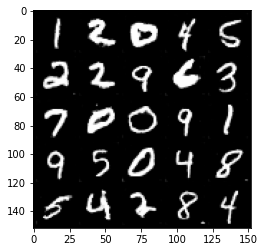

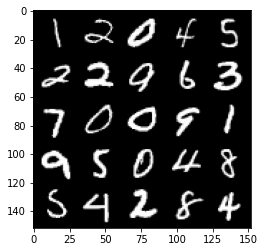

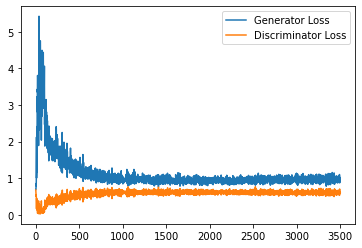

Step 70500: Generator loss: 0.9760374962091446, discriminator loss: 0.603394945204258


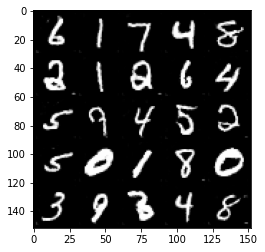

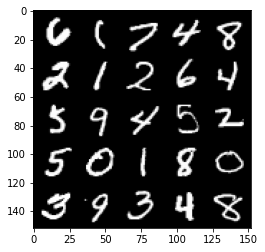

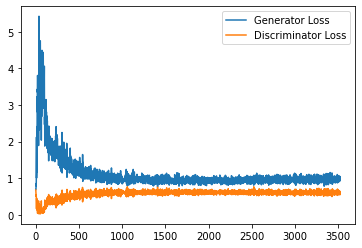

Step 71000: Generator loss: 0.9789023197889328, discriminator loss: 0.6075196066498756


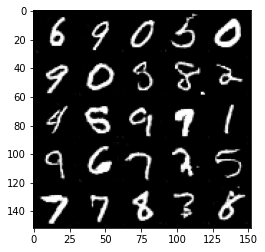

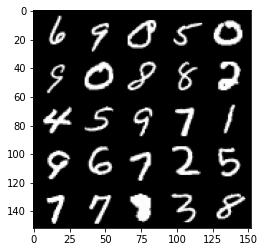

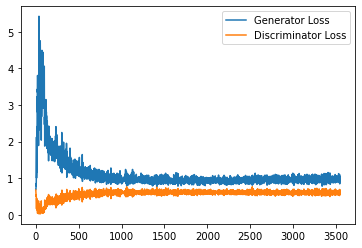

Step 71500: Generator loss: 0.9717708033323288, discriminator loss: 0.6038489171266556


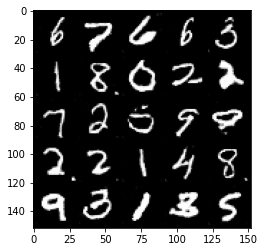

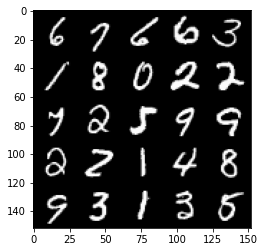

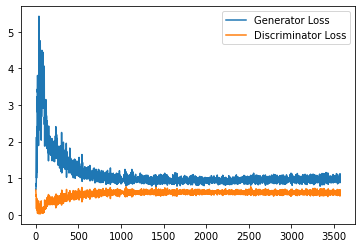

Step 72000: Generator loss: 0.9822010600566864, discriminator loss: 0.5995201650857925


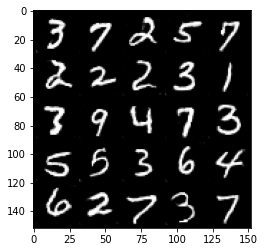

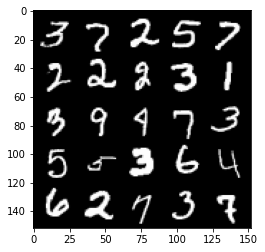

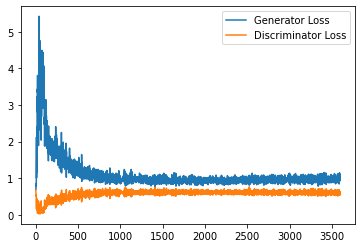

Step 72500: Generator loss: 0.983105610370636, discriminator loss: 0.6056484042406082


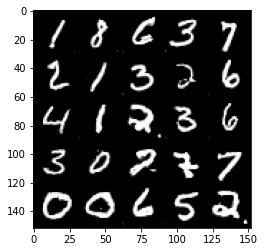

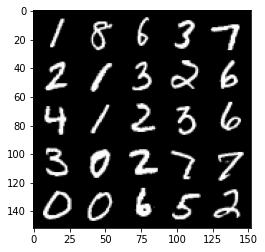

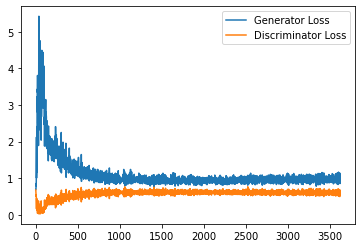

Step 73000: Generator loss: 0.96473313498497, discriminator loss: 0.6051289032101631


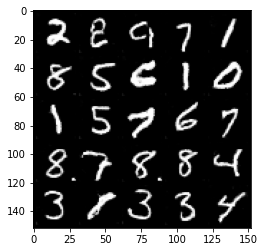

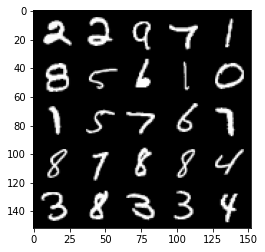

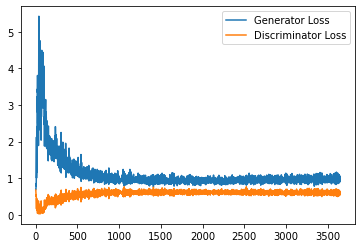

Step 73500: Generator loss: 0.962543425321579, discriminator loss: 0.6053651745915413


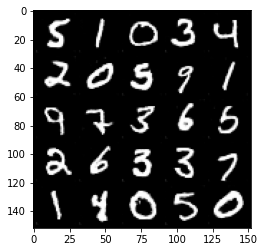

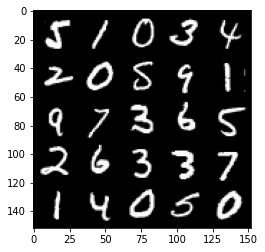

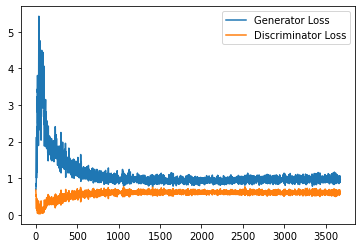

Step 74000: Generator loss: 0.9670857968330383, discriminator loss: 0.5986813495159149


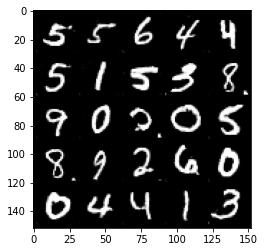

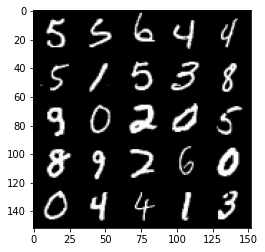

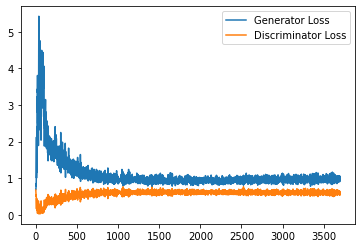

Step 74500: Generator loss: 0.9770522949695587, discriminator loss: 0.6054402623176575


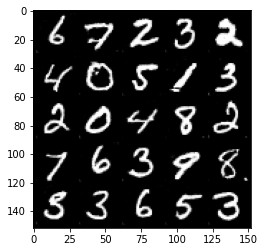

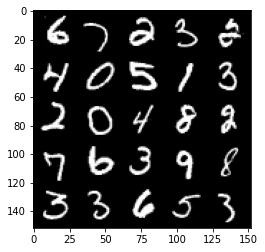

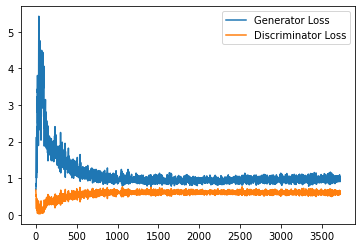

Step 75000: Generator loss: 0.959556592464447, discriminator loss: 0.6039926737546921


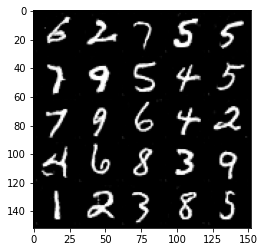

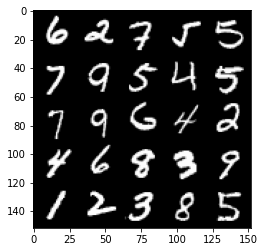

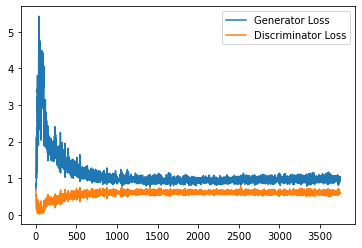

Step 75500: Generator loss: 0.9568061004877091, discriminator loss: 0.6058120706677437


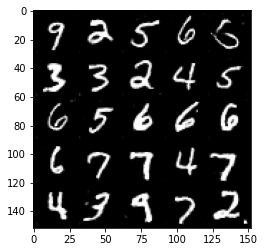

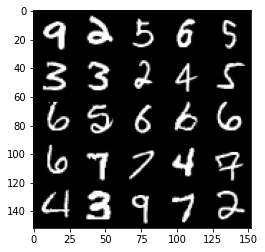

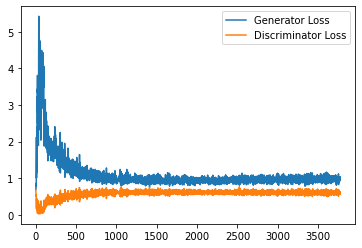

Step 76000: Generator loss: 0.9630370701551437, discriminator loss: 0.6028840732574463


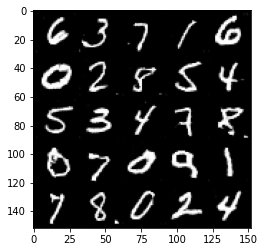

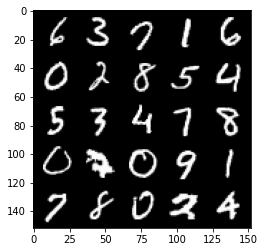

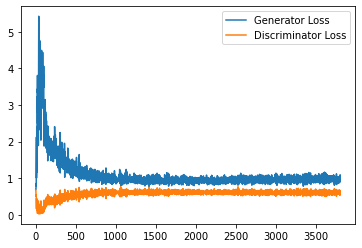

Step 76500: Generator loss: 0.9563854488134385, discriminator loss: 0.6089327222704888


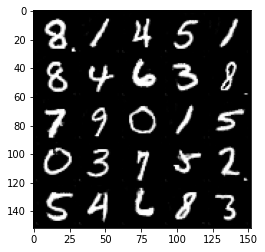

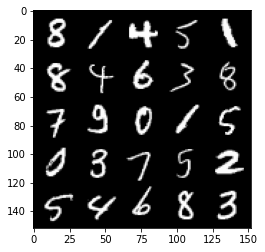

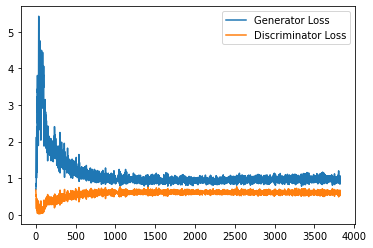

Step 77000: Generator loss: 0.9751646380424499, discriminator loss: 0.603018680870533


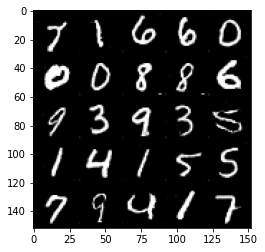

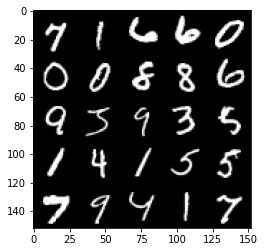

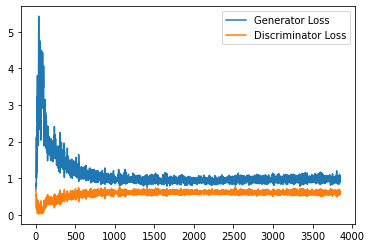

Step 77500: Generator loss: 0.9605482448339462, discriminator loss: 0.610611058652401


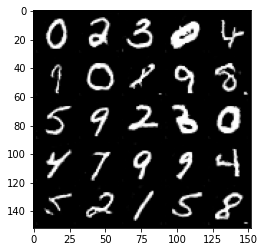

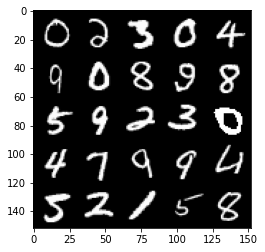

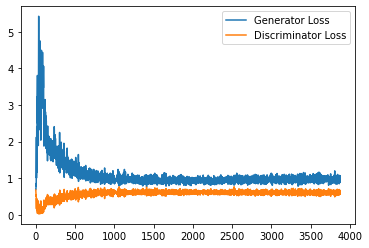

Step 78000: Generator loss: 0.9767061394453048, discriminator loss: 0.6088212871551514


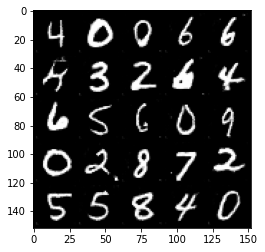

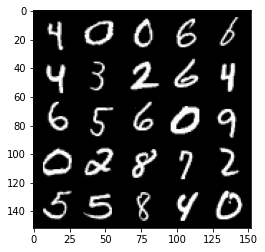

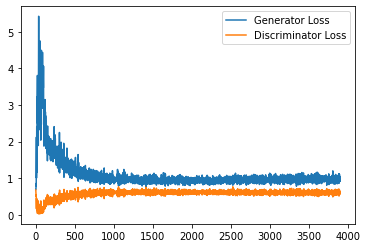

Step 78500: Generator loss: 0.9529354296922684, discriminator loss: 0.6108255797624588


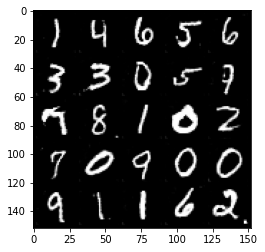

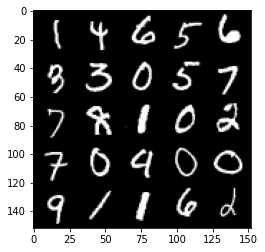

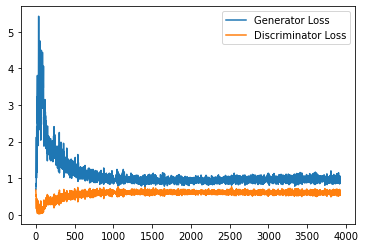

Step 79000: Generator loss: 0.9595543179512024, discriminator loss: 0.6059484575986862


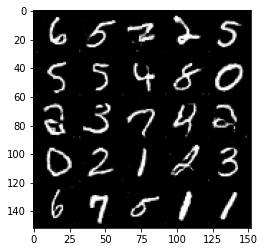

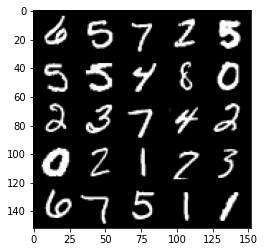

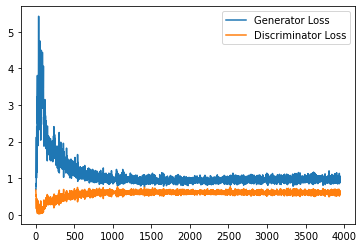

Step 79500: Generator loss: 0.9572287909984588, discriminator loss: 0.6042578312158584


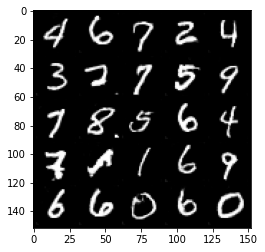

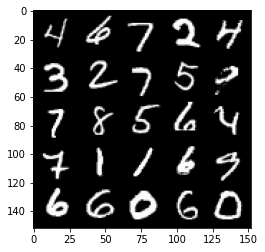

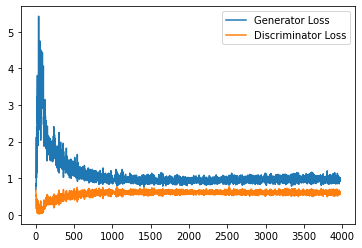

Step 80000: Generator loss: 0.9541467871665955, discriminator loss: 0.6096176816821098


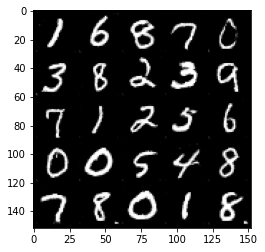

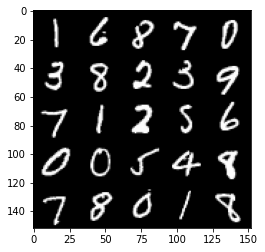

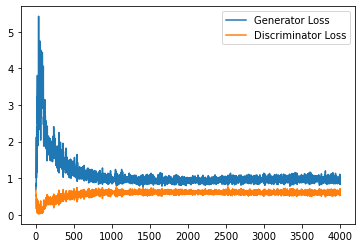

Step 80500: Generator loss: 0.9759301328659058, discriminator loss: 0.6081690185070038


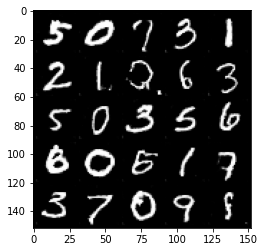

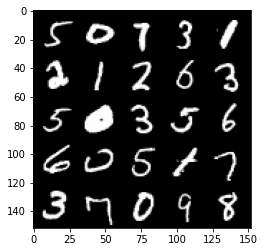

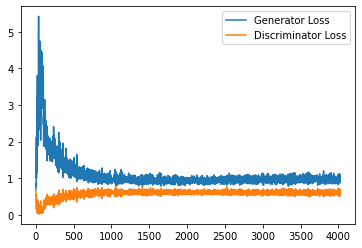

Step 81000: Generator loss: 0.967437591791153, discriminator loss: 0.6093557314276695


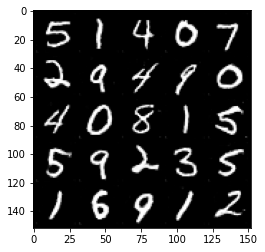

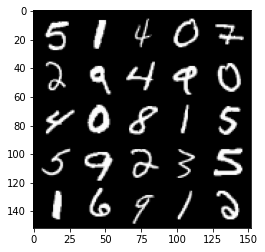

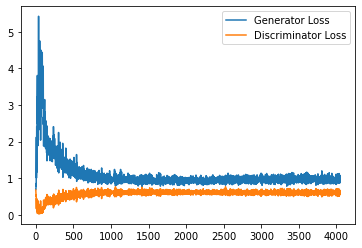

Step 81500: Generator loss: 0.9642458786964416, discriminator loss: 0.610546362221241


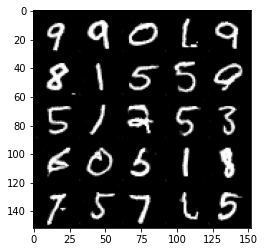

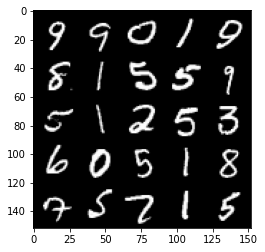

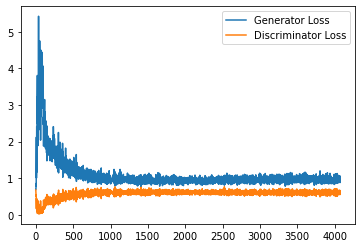

Step 82000: Generator loss: 0.9721621564626693, discriminator loss: 0.6084409785866738


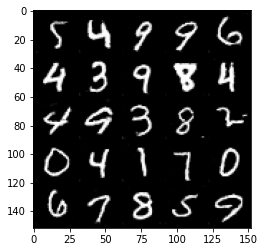

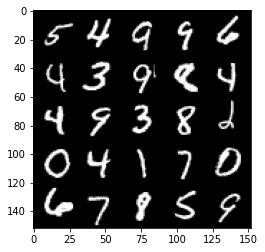

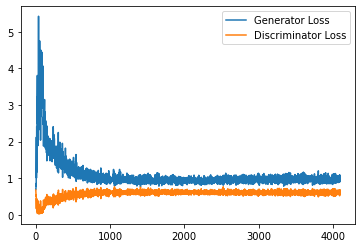

Step 82500: Generator loss: 0.9744640246629716, discriminator loss: 0.6147056258320809


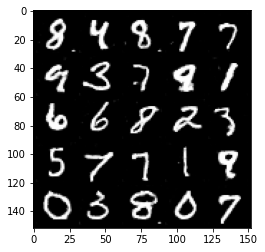

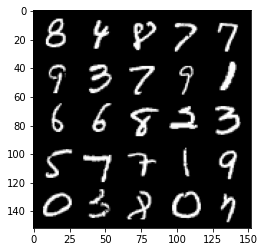

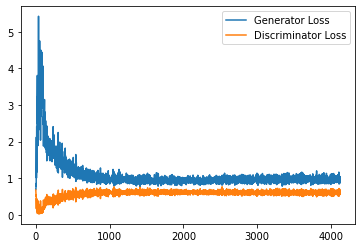

Step 83000: Generator loss: 0.9657161206007003, discriminator loss: 0.6138207201957703


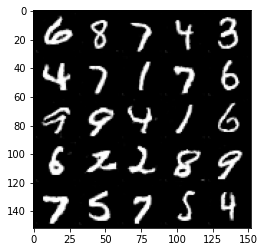

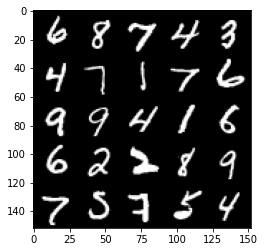

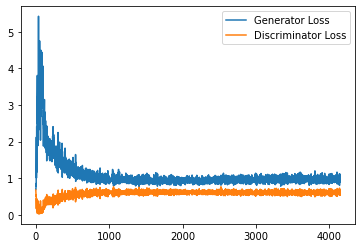

Step 83500: Generator loss: 0.9600010203123093, discriminator loss: 0.6084381483793259


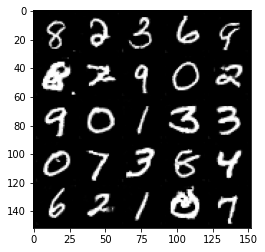

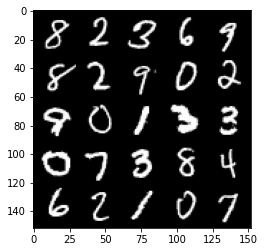

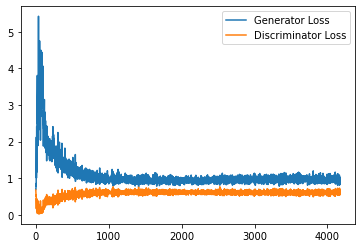

Step 84000: Generator loss: 0.9478909018039703, discriminator loss: 0.6052657770514488


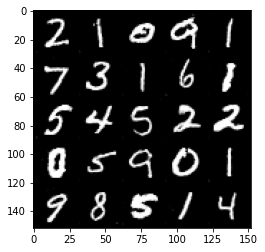

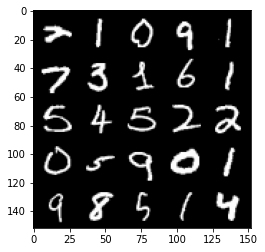

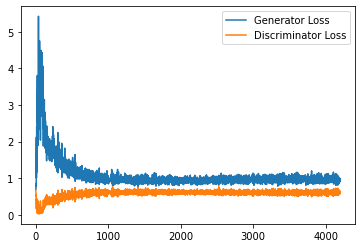

Step 84500: Generator loss: 0.9824867287874222, discriminator loss: 0.6102026208639145


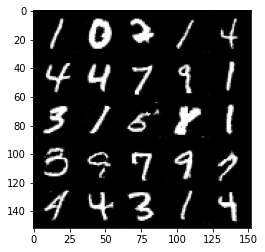

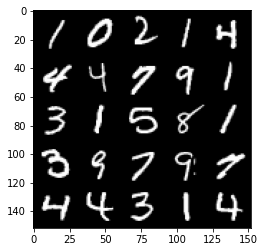

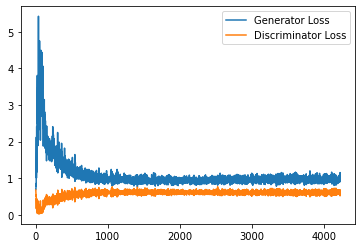

Step 85000: Generator loss: 0.977936485528946, discriminator loss: 0.6187578074336052


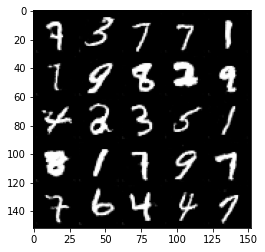

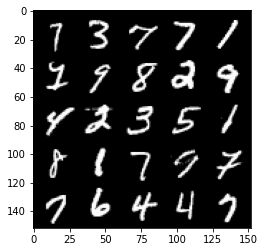

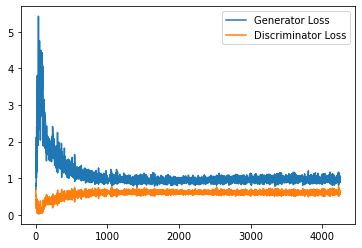

Step 85500: Generator loss: 0.9657953931093216, discriminator loss: 0.6104628250598908


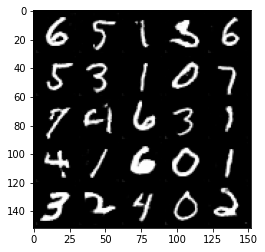

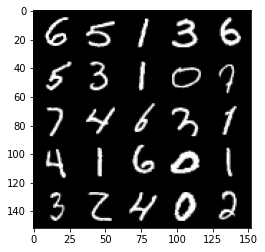

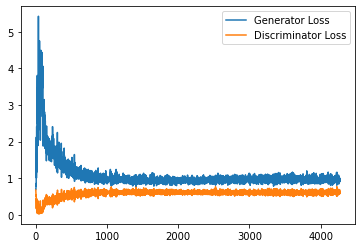

Step 86000: Generator loss: 0.967915764927864, discriminator loss: 0.611079229593277


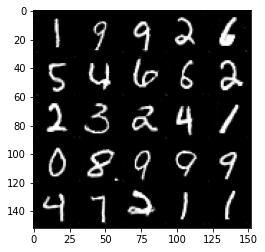

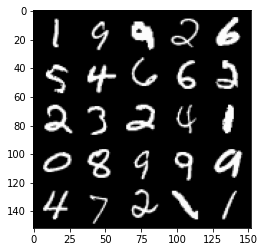

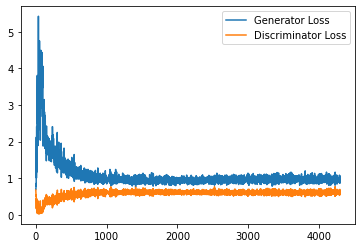

Step 86500: Generator loss: 0.9481610757112503, discriminator loss: 0.6160045601725578


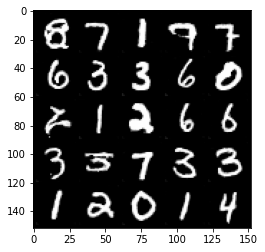

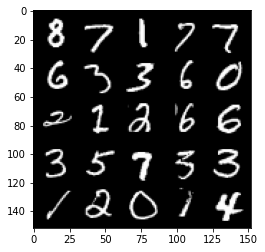

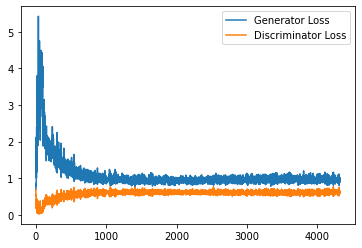

Step 87000: Generator loss: 0.9584387372732163, discriminator loss: 0.6144987923502923


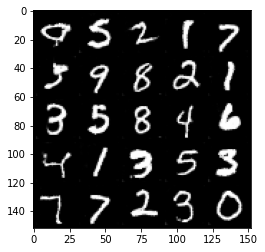

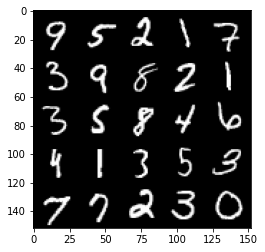

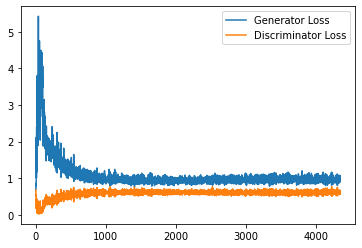

Step 87500: Generator loss: 0.9637951776981354, discriminator loss: 0.6165830706357955


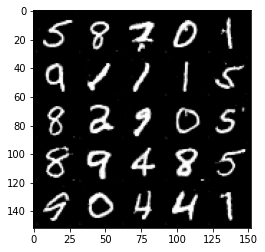

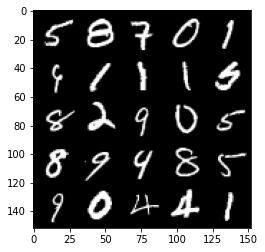

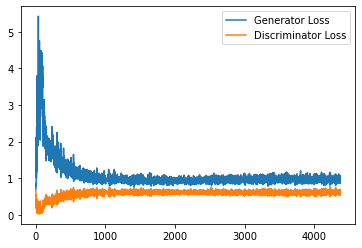

Step 88000: Generator loss: 0.9605763453245163, discriminator loss: 0.615615822672844


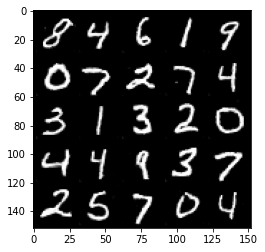

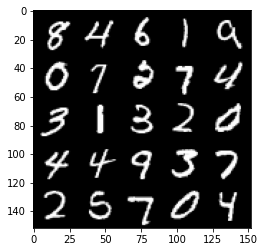

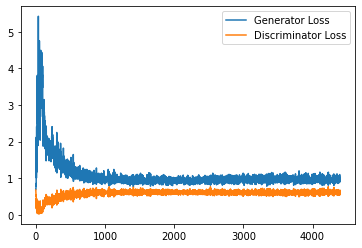

Step 88500: Generator loss: 0.967543329000473, discriminator loss: 0.6135246136188507


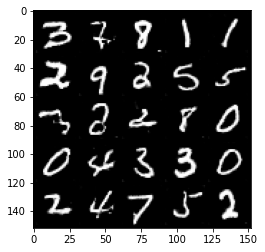

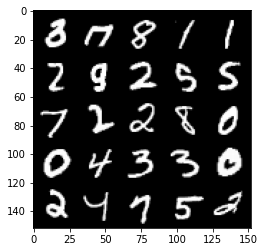

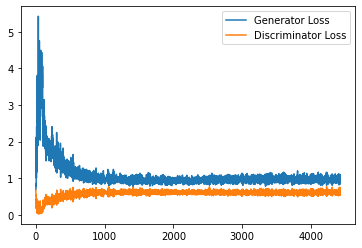

Step 89000: Generator loss: 0.955842962384224, discriminator loss: 0.6124579945206642


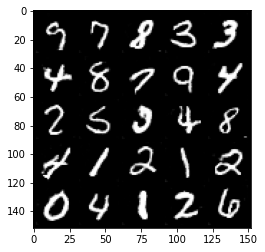

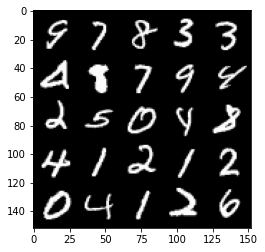

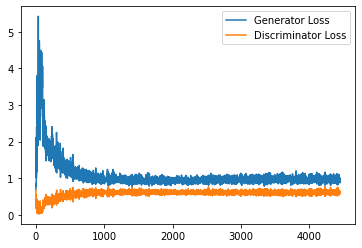

Step 89500: Generator loss: 0.9733434982299805, discriminator loss: 0.6100188980102539


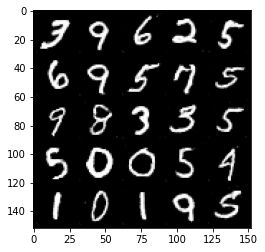

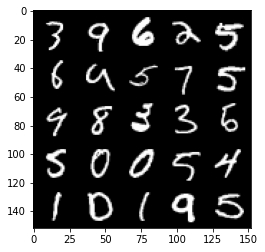

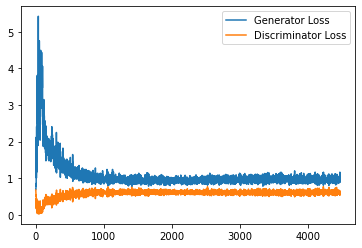

Step 90000: Generator loss: 0.9503098441362381, discriminator loss: 0.6269897104501724


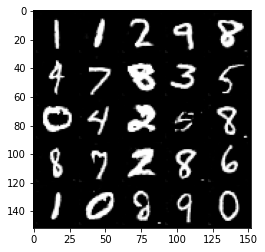

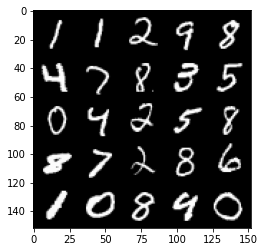

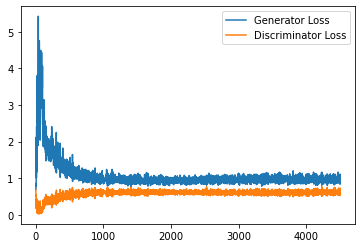

Step 90500: Generator loss: 0.9386346524953842, discriminator loss: 0.6196261295676231


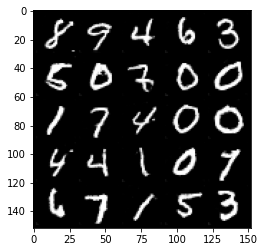

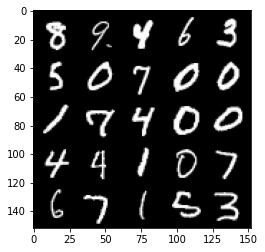

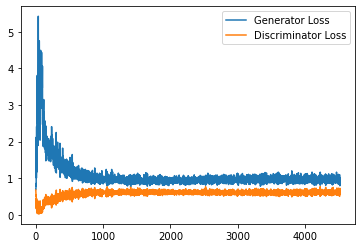

Step 91000: Generator loss: 0.942737456202507, discriminator loss: 0.6199360994100571


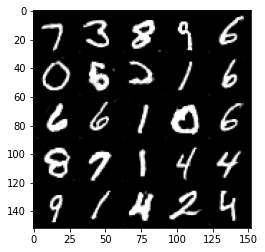

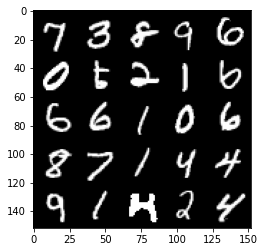

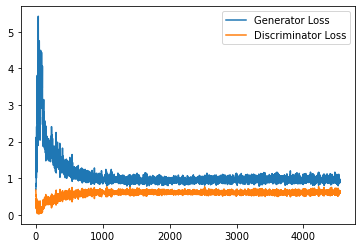

Step 91500: Generator loss: 0.9497224010229111, discriminator loss: 0.6198540461063385


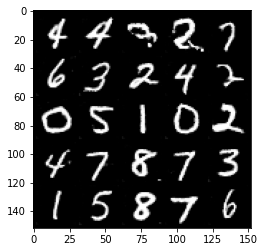

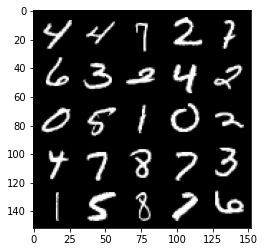

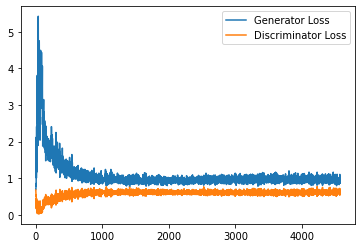

Step 92000: Generator loss: 0.9479751670360566, discriminator loss: 0.6162366416454316


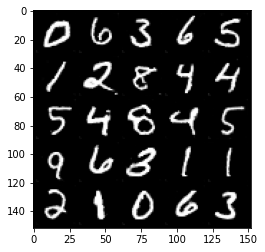

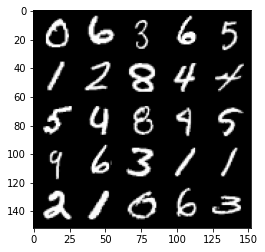

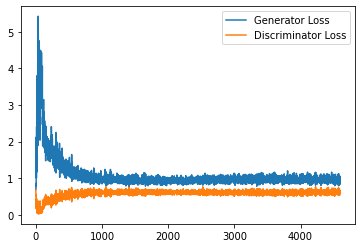

Step 92500: Generator loss: 0.9406878329515457, discriminator loss: 0.619646821975708


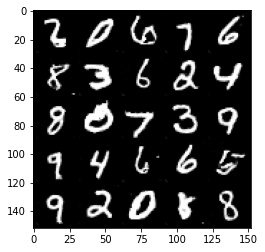

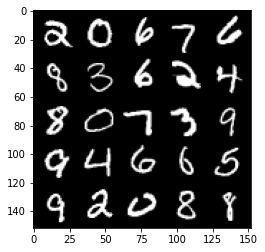

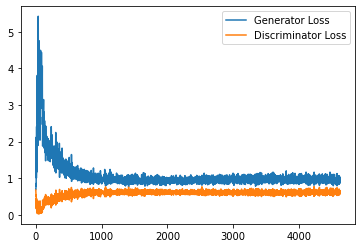

Step 93000: Generator loss: 0.9488011602163314, discriminator loss: 0.6207147775888443


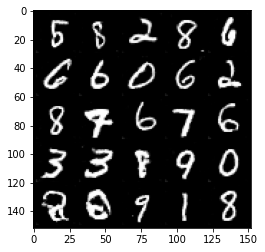

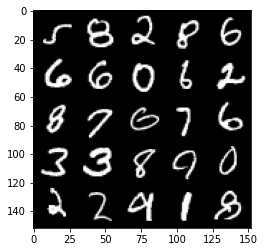

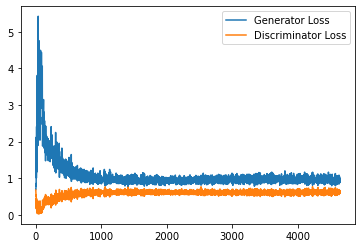

Step 93500: Generator loss: 0.9522365573644638, discriminator loss: 0.621583490550518


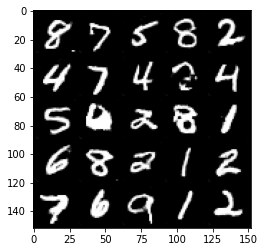

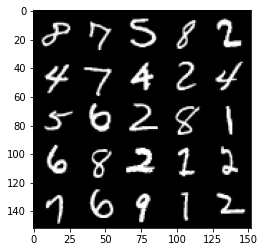

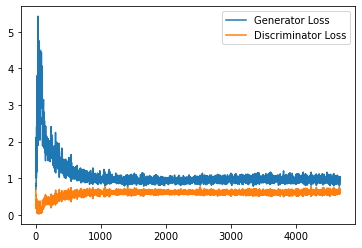

In [57]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [61]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

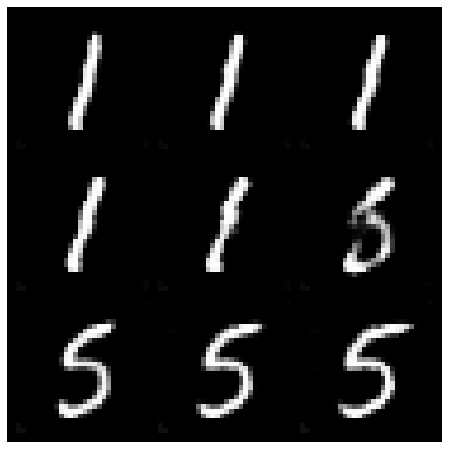

In [62]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

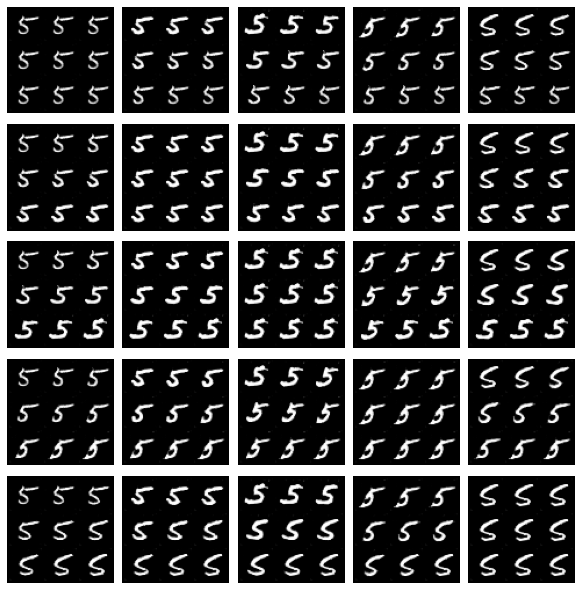

In [63]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()